In [2]:
import ipdb
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pylab as pylab
import cartopy
import cartopy.crs as ccrs
from utils import constants as cnst
from eod import msg
from utils import u_darrays as uda
import datetime
# import salem
# from salem import get_demo_file, DataLevels, GoogleVisibleMap, Map
import shapely.geometry as shpg
import glob
import pickle as pkl
import os
from scipy.stats import binned_statistic_2d
from scipy import stats
from endgame import hist2d
from utils import u_statistics as u_stats



pylab.rcParams['figure.figsize'] = (10., 5.)
%matplotlib inline

In [1]:
cd ..

/home/ck/pythonWorkspace/proj_CEH


In [3]:
months_n = (5,8)
months_s = (11,2)

 
MREGIONS = {
 'GPlains' : [[-100,-90,32,47], 'nam', -6, (1,7), months_n, (1,12)], # # 18  
 'china' : [[105,115,25,40], 'asia', 8 , (1,7), months_n, (1,12)], # 4
 'india' : [[70,90, 5,30], 'asia', 5, (1,7), months_n, (1,12)], # 7
 'WAf' : [[-18,25,4,25], 'spac', 0, (1,7), months_n, (1,12)], # last is hourly offset to UCT # 12    # [-18,25,4,25]
 'australia' : [[120,140,-23, -11], 'asia', 9, (11,3),months_s, (1,12)], # 3
 'SAf' : [[20,35, -35,-15], 'spac', 2, (9,12), months_s, (11,3)], # 10
 'sub_SA' : [[-68,-47, -40, -20.5], 'spac', -4, (11,3), months_s, (1,12)] , # 16
# 'trop_SA' : [[-75, -50, -20, -5], 'spac', -5, (1,12), (1,12), (1,12)], # 17


}

In [4]:
rdics = {}
for regs in MREGIONS.keys():
    for ids, y in enumerate(range(2000,2021)):
        #'ipdb.set_trace()
        try:
            test = pd.read_csv(glob.glob('/media/ck/LStorage/global_water/ERA5_MCS_saveFiles/trackv2_ERA12LT/'+regs+'_ERA5_2000-2019_MCSTRACK_localBulk*_'+str(y)+'*_FullYear.csv')[0])
        except:
            ipdb.set_trace()
#         test = pd.read_csv(glob.glob('/media/ck/LStorage/global_water/save_files_v2/'+regs+'_mcs_tracks_final_'+str(y)+'*.csv')[0])
        if ids == 0:
            test2 = pd.DataFrame(test)
        else :
            test2 = pd.concat([test2, test])
    rdics[regs] = test2

In [6]:
snapdics = {}
for regs in MREGIONS.keys():
    for ids, y in enumerate(range(2000,2021)):
        #'ipdb.set_trace()
        try:
            test = pd.read_csv(glob.glob('/media/ck/LStorage/global_water/MCS_5000km2_tables/ERA5_added_12LT/'+regs+'/'+str(y)+'*.csv')[0])
        except:
            ipdb.set_trace()
    #      
        if ids == 0:
            test2 = pd.DataFrame(test)
        else :
            test2 = pd.concat([test2, test])
            
    test2 = test2[test2['precipitation_max']>=2]
    snapdics[regs] = test2

In [7]:
print(list(rdics['WAf'].keys()))

['direction', 'tminlon', 'tminlat', 'tmin_calc', 'tmin', 'tmean_core', 'tmean_ccs', 'tcwv', 'tgrad2m', 'tgrad925', 'smgrad', 'efgrad', 'shgrad', 'lhgrad', 'pmax', 'pmean', 'ptot', 'q925', 'q650', 'q850', 'era_precip', 'sm', 'ef', 'u925', 'u650', 'v925', 'v650', 'w925', 'w650', 'rh925', 'rh650', 't925', 't650', 'div925', 'div850', 'div650', 'pv925', 'pv650', 'ushear925_650', 'ushear850_650', 'ushear925_850', 'ushear100m_650', 'vshear925_650', 'vshear850_650', 'vshear925_850', 'vshear100m_650', 'shear925_650', 'shear850_650', 'shear925_850', 'shear100m_650', 'cape', 't2m', 'track_duration', 'start_status', 'end_status', 'start_basetime', 'end_basetime', 'start_split_cloudnumber', 'end_merge_cloudnumber', 'base_time', 'meanlat', 'meanlon', 'area', 'cloudnumber', 'track_status', 'track_interruptions', 'core_area', 'cold_area', 'corecold_mintb', 'corecold_meantb', 'core_meantb', 'mcs_duration', 'mcs_status', 'ccs_area', 'pf_npf', 'pf_lon1', 'pf_lon2', 'pf_lon3', 'pf_lat1', 'pf_lat2', 'pf_la

In [8]:
print(list(snapdics['WAf'].keys()))

['tcwv', 'tgrad2m', 'tgrad2m_resid', 'tgrad925', 'tgrad850', 'smgrad', 'efgrad_acc', 'shgrad', 'shgrad_resid', 'lhgrad', 'shgrad_acc', 'lhgrad_acc', 'q925', 'q650', 'q850', 'era_precip', 'era_precip_acc', 'sm', 'ef_acc', 'sh_acc', 'lh_acc', 'u925', 'u650', 'v925', 'v650', 'w925', 'w650', 'rh925', 'rh650', 't925', 't650', 't850', 'div925', 'div850', 'div650', 'pv925', 'pv650', 'pv850', 'ushear925_650', 'ushear850_650', 'ushear925_850', 'ushear100m_650', 'vshear925_650', 'vshear850_650', 'vshear925_850', 'vshear100m_650', 'shear925_650', 'shear850_650', 'shear925_850', 'shear100m_650', 'cape', 't2m', 'Unnamed: 0', 'date', 'month', 'hour', 'minute', 'year', 'day', 'area', '70area', 'tmin', 'minlon', 'minlat', 'maxlon', 'maxlat', 'clon', 'clat', 'tminlon', 'tminlat', 'tmean', 'tp1', 'tp99', 'stormID', 'precipitation_mean', 'precipitation_max', 'precipitation_p95', 'precipitation_p99', 'lt_hour', 'lt_datetime', 'utc_date']


In [9]:
(snapdics['WAf']['precipitation_max']).min()

2.000041961669922

In [11]:
np.median(rdics['WAf'].pf_area1)

9000.0

In [21]:
######## partial correlation test

In [25]:
import statsmodels.api as sm

In [28]:
def cor(x, y):
    """It is annoying that np.corrcoef returns a matrix, this returns a float."""

    return np.corrcoef(x, y)[0, 1]

def pcor(x, y, c):
    """Partial correlation (r2) of x and y when the effect of C is removed.

    Couldn't find a routine to do exactly this in statsmodels, so I
    rolled my own. (F. Maussion)

    y and x are the variables from which we want to compute the correlation,
    when the effect of the controlling variables in C is removed.

    The residuals after regressing X/Y on Ci are the parts of X/Y that
    cannot be predicted by Ci. The partial correlation coefficient between
    Y and X adjusted for Ci is the correlation between these two sets of
    residuals.

    Returns
    -------
    tuple (r2, pvalue)

    """

    # Degrees of freedom
    if len(c.shape) == 1:
        df = len(x) - 2 - 1
    else:
        df = len(x) - 2 - c.shape[1]

    # Dont forget the constant
    _c = sm.add_constant(c)
    fity = sm.OLS(y, _c).fit()
    fitx = sm.OLS(x, _c).fit()

    r = cor(fitx.resid, fity.resid)
    t = r / np.sqrt((1. - r ** 2) / df)
    p_e = stats.t.sf(np.abs(t), df) * 2  # error probability (two tailed)

    return r, p_e


In [46]:
pcor(snapdics['WAf'].smgrad, snapdics['WAf'].ushear925_650, snapdics['WAf'].tgrad2m)

(0.08026001864589702, 0.0)

In [55]:
pcor(snapdics['WAf'].tgrad925, snapdics['WAf'].ushear925_650, snapdics['WAf'].tgrad2m)

(-0.21465628686458121, 0.0)

In [56]:
stats.pearsonr(snapdics['WAf'].tgrad925, snapdics['WAf'].ushear925_650)

PearsonRResult(statistic=-0.3234723328532376, pvalue=0.0)

In [57]:
stats.pearsonr(snapdics['WAf'].tgrad2m, snapdics['WAf'].ushear925_650)

PearsonRResult(statistic=-0.29252324722256345, pvalue=0.0)

In [47]:
# A on C significant
stats.pearsonr(snapdics['WAf'].smgrad, snapdics['WAf'].ushear925_650)

PearsonRResult(statistic=0.13679658697899513, pvalue=0.0)

In [49]:
# A on B significant
stats.pearsonr(snapdics['WAf'].smgrad, snapdics['WAf'].tgrad925)

PearsonRResult(statistic=-0.1901925606232661, pvalue=0.0)

In [50]:
# B on C significant
stats.pearsonr(snapdics['WAf'].tgrad925, snapdics['WAf'].ushear925_650)

PearsonRResult(statistic=-0.3234723328532376, pvalue=0.0)

In [51]:
# B effect on C when accounting for a
pcor(snapdics['WAf'].tgrad925, snapdics['WAf'].ushear925_650, snapdics['WAf'].smgrad)

(-0.30586043070121643, 0.0)

In [53]:
# c' insignificant when accounting for B
pcor(snapdics['WAf'].smgrad, snapdics['WAf'].ushear925_650, snapdics['WAf'].tgrad925)

(0.08103049456668991, 0.0)

In [54]:
0.08/0.14

0.5714285714285714

In [19]:
## needs to be adapted

from utils import u_met
def calc_theta_table(da, moist=False):    
    p = 1000

    t = da['t2_1deg'].values - 273.15
    q = da['q2_1deg'].values
    
    if moist:
        theta = u_met.theta_e(p, t, q)
    else:
        theta = u_met.theta(p,t) 
        
        
    p = 925
    
    t = da['t_srfc_1deg'].values
    q = da['q_srfc_1deg'].values/1000
    
    if moist:
        theta2 = u_met.theta_e(p, t, q)
    else:
        theta2 = u_met.theta(p,t) 
    
    return np.array((theta2+theta)/2)

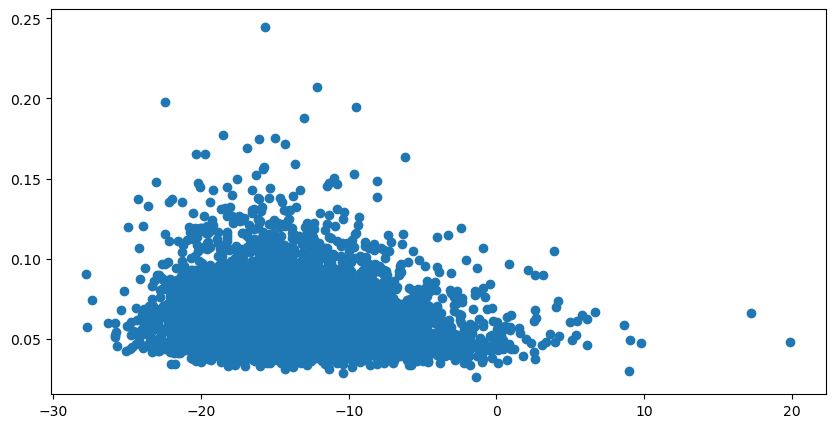

In [87]:
treg= 'WAf'
mask = (rdics[treg]['pf_maxrainrate1']>=10) &  (rdics[treg]['pf_lat1']>=10) & np.isfinite(rdics[treg]['pf_accumrainheavy1']) & np.isfinite(rdics[treg]['pf_accumrain1'])
plt.scatter((rdics[treg]['ushear100m_650']).values[mask],  (rdics[treg]['pf_accumrain1']).values[mask]/(rdics[treg]['pf_area1']).values[mask])

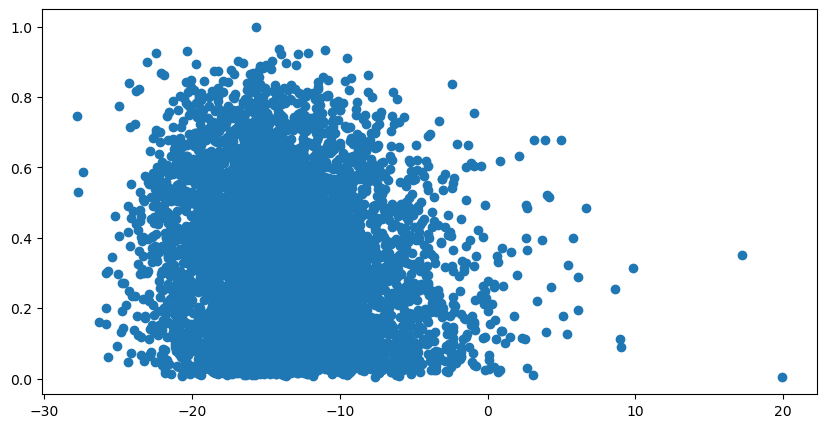

In [86]:
treg= 'WAf'
mask = (rdics[treg]['pf_maxrainrate1']>=10) &  (rdics[treg]['pf_lat1']>=10) & np.isfinite(rdics[treg]['pf_accumrainheavy1']) & np.isfinite(rdics[treg]['pf_accumrain1'])
plt.scatter((rdics[treg]['ushear100m_650']).values[mask],  (rdics[treg]['pf_accumrainheavy1']).values[mask]/(rdics[treg]['pf_accumrain1']).values[mask])
#plt.ylim(0,100000)

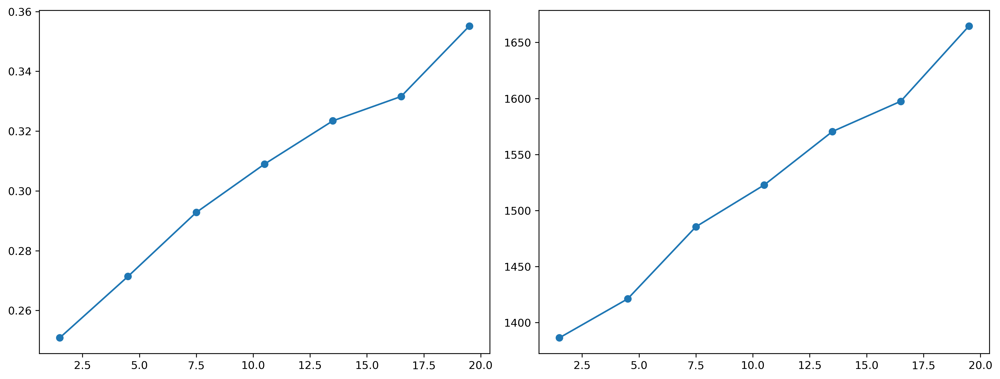

In [95]:
f= plt.figure(figsize=(13,5), dpi=300)
regs='WAf'

mask = np.isfinite(rdics[regs]['pf_accumrainheavy1']) & np.isfinite(rdics[regs]['pf_accumrain1'])

ax = f.add_subplot(121)
outdic = hist2d.var2_binning_mean((rdics[regs]['shear100m_650']).values[mask], (rdics[regs]['pf_accumrainheavy1']).values[mask]/(rdics[regs]['pf_accumrain1']).values[mask], np.arange(0,22,3))
plt.plot(outdic['xbins'], outdic['y'], '-o')
plt.tight_layout()

ax = f.add_subplot(122)

mask = np.isfinite(rdics[regs]['pf_accumrainheavy1']) & np.isfinite(rdics[regs]['pf_accumrain1'])

pplot = (rdics[regs]['pf_accumrain1']).values[mask]/(rdics[regs]['pf_area1']).values[mask]

outdic = hist2d.var2_binning_mean((rdics[regs]['shear100m_650']).values[mask], (rdics[regs]['pf_accumrain1']).values[mask]/(rdics[regs]['pf_area1']).values[mask], np.arange(0,22,3))
plt.plot(outdic['xbins'], np.array(outdic['y'])*25000, '-o')
plt.tight_layout()

#f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_trackVSsnapshot_tmin-pmaxgt20.jpg')

GPlains PearsonRResult(statistic=0.9064396447503946, pvalue=0.0)
china PearsonRResult(statistic=0.8958214879275607, pvalue=5.2577967209670545e-168)
india PearsonRResult(statistic=0.890244975827979, pvalue=0.0)
WAf PearsonRResult(statistic=0.8796020154963624, pvalue=0.0)
australia PearsonRResult(statistic=0.8832772744267999, pvalue=0.0)
SAf PearsonRResult(statistic=0.8815249239428306, pvalue=0.0)
sub_SA PearsonRResult(statistic=0.9061052300408877, pvalue=0.0)


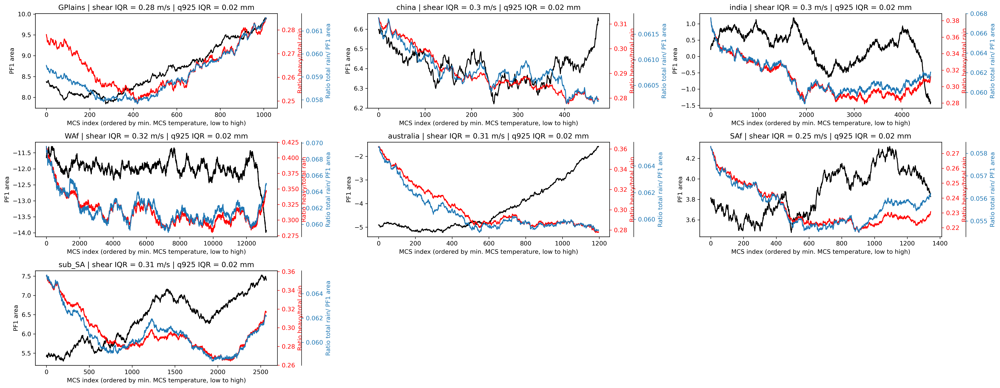

In [49]:
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

f= plt.figure(figsize=(23,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = rdics[regs]
    
    obsord = obs[np.isfinite(obs['ushear100m_650']) & np.isfinite(obs['pf_accumrainheavy1']) & np.isfinite(obs['pf_accumrain1'])] # & np.isfinite(obs['q925']) & np.isfinite(obs['t925'])
    inds = np.argsort(obsord['pf_area1'])

    minus = -20000
    pro = obsord['ushear100m_650'].values[inds]#[minus::]
    sho = (obsord['pf_accumrainheavy1'].values/obsord['pf_accumrain1'].values)[inds]#[minus::]
    tco =(obsord['pf_accumrain1'].values/obsord['pf_area1'].values)[inds]#[minus::]
#     qco = obsord['q925'].values[inds]#[minus::]
#     temp = obsord['t925'].values[inds]#[minus::]
#     qupco = obsord['q650'].values[inds]#[minus::]
    
#     if ids in [2,3,4]: 
#         sho = sho * -1
#         print(regs, 'doing minus 1')

    #tco = tco * -1
        #sho = sho * -1

    
    ax2 = ax.twinx()
    #ax3 = ax.twinx()
    ax4 = ax.twinx()

    agg = 500


    # Offset the right spine of twin2.  The ticks and label have already been
    # placed on the right by twinx above.
    #ax2.spines["right"].set_position(("axes", 1.02))
    #ax3.spines["right"].set_position(("axes", 1.1))
    ax4.spines["right"].set_position(("axes", 1.1))

    ax.plot(moving_average(pro,agg), label='pf1 area', color='k')
    #ax.invert_yaxis()
    
    plt.title(regs+' | shear IQR = '+str(np.round(np.nanpercentile(sho,75)-np.nanpercentile(sho,25),2))+' m/s' + ' | q925 IQR = '+str(np.round(np.nanpercentile(tco,75)-np.nanpercentile(tco,25),2))+' mm')

    p4, = ax4.plot(moving_average(tco,agg), label='accum_rain/area')
    p2, = ax2.plot(moving_average(sho,agg), label='heavy/total rain', color='r')
#     if ids in [2,3,4]: 
#         print(regs, 'doing minus 1')
#         ax2.invert_yaxis()
    #p3, = ax3.plot(moving_average(qco,500), label='q925', color='purple')
    #p4, = ax4.plot(moving_average(temp,500), label='t925', color='orange')

    ax2.yaxis.label.set_color(p2.get_color())
    #ax3.yaxis.label.set_color(p3.get_color())
    ax4.yaxis.label.set_color(p4.get_color())

    tw = moving_average(tco,agg)
    twd = tw[1::]-tw[0:-1]
    sw = moving_average(sho,agg)
    swd = sw[1::]-sw[0:-1]

    print(regs, stats.pearsonr(twd,swd))

    ax.set_ylabel('PF1 area')
    ax2.set_ylabel('Ratio heavy/total rain')
    ax4.set_ylabel('Ratio total rain/ PF1 area')


    ax2.tick_params(axis='y', colors=p2.get_color())
    #ax3.tick_params(axis='y', colors=p3.get_color() )
    ax4.tick_params(axis='y', colors=p4.get_color())

    
    ax.set_xlabel('MCS index (ordered by min. MCS temperature, low to high)')

    
plt.tight_layout()
#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/minT_ordered_maxRain_shear_q925.jpg')

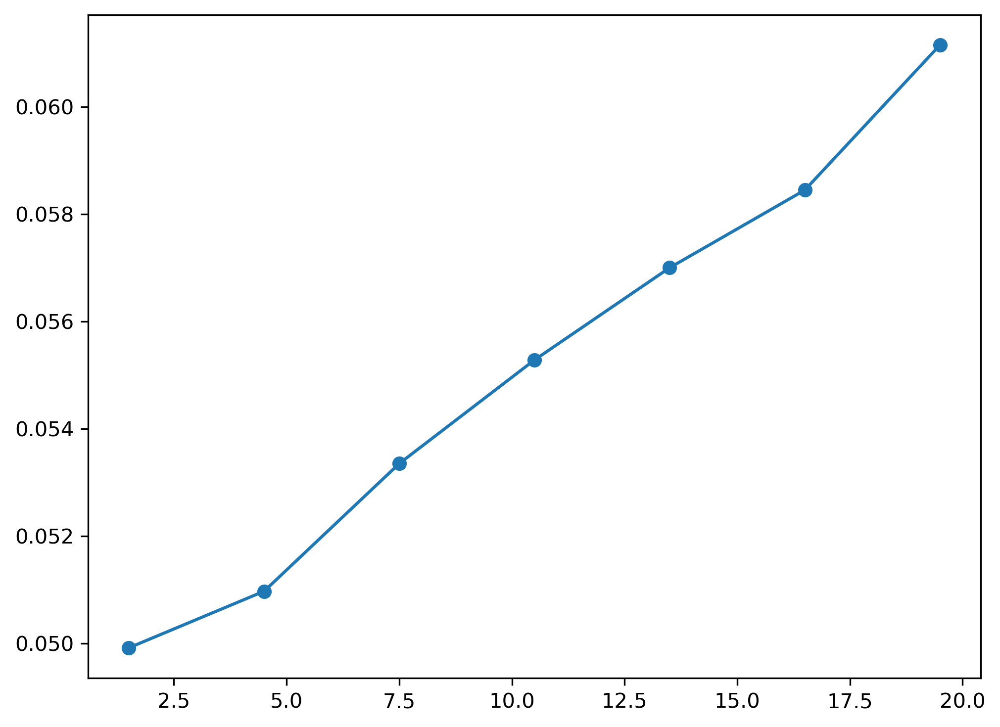

In [34]:
f= plt.figure(figsize=(13,5), dpi=300)
regs='WAf'

mask = np.isfinite(rdics[regs]['pf_accumrain1']) & np.isfinite(rdics[regs]['pf_area1'])

ax = f.add_subplot(121)
outdic = hist2d.var2_binning_mean((rdics[regs]['shear100m_650']).values[mask], (rdics[regs]['pf_accumrain1']).values[mask]/(rdics[regs]['pf_area1']).values[mask], np.arange(0,22,3))
plt.plot(outdic['xbins'], outdic['y'], '-o')
plt.tight_layout()

# ax = f.add_subplot(122)

# outdic = hist2d.var2_binning_threshold((rdics[regs]['corecold_mintb']-273.15).values, (rdics[regs]['pf_maxrainrate1']).values, np.arange(-90,-40,5), gt=20)
# plt.plot(outdic['xbins'], outdic['y'], '-o')
# plt.title(regs+' MCS tracks | n='+str(len(rdics[regs]['corecold_mintb'])))
# ax.set_ylim(0,1)
# plt.ylabel('P Precip > 20mm')
# plt.xlabel('Cold core min T')

plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_trackVSsnapshot_tmin-pmaxgt20.jpg')

/home/ck/pythonWorkspace/proj_CEH/endgame/hist2d.py:437: RuntimeWarning: invalid value encountered in divide
  outdic['y'].append(np.sum(yvar[mask]>gt)/float(np.sum(np.isfinite(yvar[mask]))))


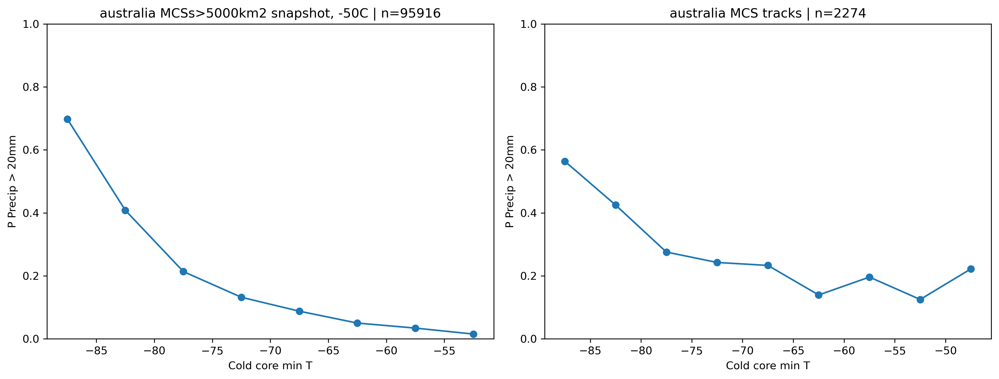

In [10]:
f= plt.figure(figsize=(13,5), dpi=300)
regs='australia'

ax = f.add_subplot(121)
outdic = hist2d.var2_binning_threshold((snapdics[regs]['tmin']).values, (snapdics[regs]['precipitation_max']).values, np.arange(-90,-40,5), gt=20)
plt.plot(outdic['xbins'], outdic['y'], '-o')
plt.title(regs+' MCSs>5000km2 snapshot, -50C | n='+str(len(test2['tmin'])))
ax.set_ylim(0,1)
plt.ylabel('P Precip > 20mm')
plt.xlabel('Cold core min T')
plt.tight_layout()

ax = f.add_subplot(122)

outdic = hist2d.var2_binning_threshold((rdics[regs]['corecold_mintb']-273.15).values, (rdics[regs]['pf_maxrainrate1']).values, np.arange(-90,-40,5), gt=20)
plt.plot(outdic['xbins'], outdic['y'], '-o')
plt.title(regs+' MCS tracks | n='+str(len(rdics[regs]['corecold_mintb'])))
ax.set_ylim(0,1)
plt.ylabel('P Precip > 20mm')
plt.xlabel('Cold core min T')

plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_trackVSsnapshot_tmin-pmaxgt20.jpg')

/home/ck/miniconda3/lib/python3.10/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/ck/miniconda3/lib/python3.10/site-packages/numpy/core/_methods.py:192: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/home/ck/miniconda3/lib/python3.10/site-packages/numpy/core/_methods.py:269: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/ck/miniconda3/lib/python3.10/site-packages/numpy/core/_methods.py:226: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/home/ck/miniconda3/lib/python3.10/site-packages/numpy/core/_methods.py:261: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


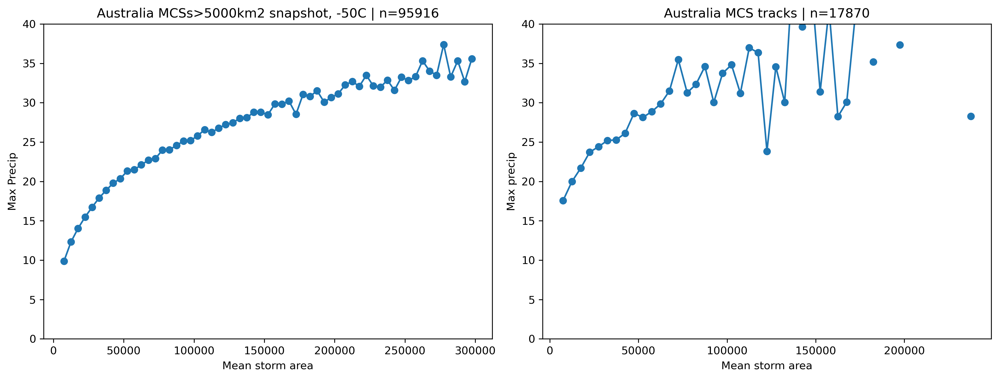

In [11]:
f= plt.figure(figsize=(13,5), dpi=300)
regs = 'WAf'
ax = f.add_subplot(121)
outdic = hist2d.var2_binning_mean((snapdics[regs]['area']).values, (snapdics[regs]['precipitation_max']).values, np.arange(5000,500000,5000))

plt.plot(outdic['xbins'], outdic['y'], '-o')
plt.title('Australia MCSs>5000km2 snapshot, -50C | n='+str(len(test2['tmin'])))

plt.ylabel('Max Precip')
plt.xlabel('Mean storm area')
plt.tight_layout()
ax.set_ylim(0,40)

ax = f.add_subplot(122)
outdic = hist2d.var2_binning_mean((rdics[regs]['pf_area1']).values, (rdics[regs]['pf_maxrainrate1']).values, np.arange(5000,500000,5000))
plt.plot(outdic['xbins'], outdic['y'], '-o')
plt.title('Australia MCS tracks | n='+str(len(rdics[regs]['corecold_mintb'])))
ax.set_ylim(0,40)

plt.ylabel('Max precip')
plt.xlabel('Mean storm area')

plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_trackVSsnapshot_pmax_stormArea.jpg')

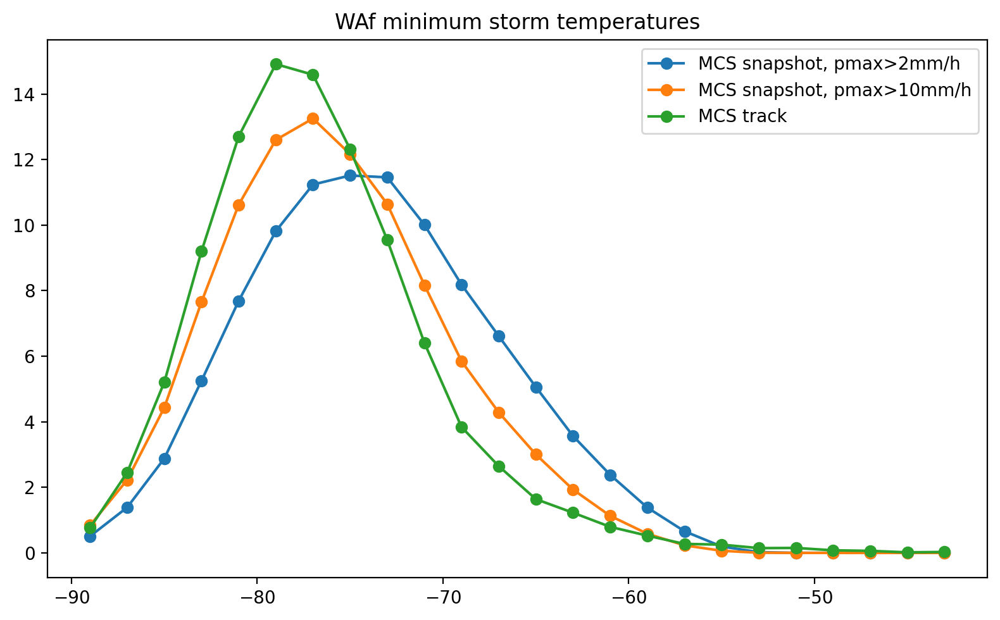

In [12]:
f= plt.figure(figsize=(8,5), dpi=200)

regs = 'WAf'

ax = f.add_subplot(111)

pick = snapdics[regs]

hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['tmin'], bins=np.arange(-90,-40,2))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, marker='o', label='MCS snapshot, pmax>2mm/h')
ax.set_title(regs+' minimum storm temperatures')

subpick = pick[pick['precipitation_max']>=10]
hist_freq, hist_count, bin_edge = u_stats.histo_frequency(subpick['tmin'], bins=np.arange(-90,-40,2))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, marker='o', label='MCS snapshot, pmax>10mm/h')

hist_freq, hist_count, bin_edge = u_stats.histo_frequency(rdics[regs]['corecold_mintb']-273.15, bins=np.arange(-90,-40,2))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, marker='o', label='MCS track')
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_mint_dist.jpg')
plt.legend()
plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_tmin_pmaxgt2mm.jpg')

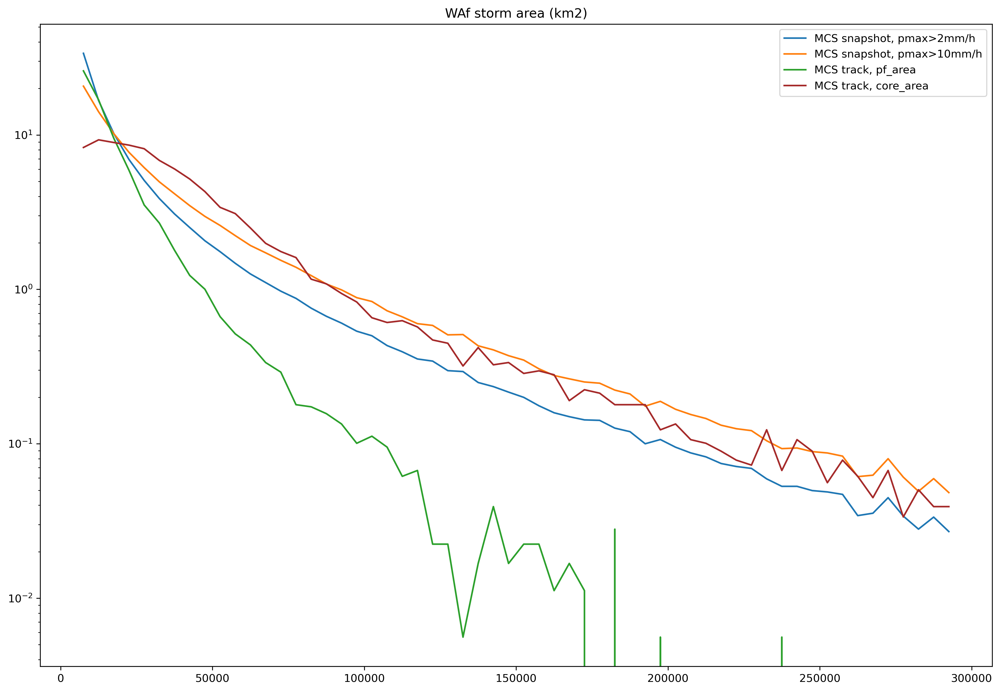

In [13]:
f= plt.figure(figsize=(13,9), dpi=300)

regs = 'WAf'

ax = f.add_subplot(111)

pick = snapdics[regs]

hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['area'], bins=np.arange(5000,300000,5000))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, label='MCS snapshot, pmax>2mm/h')
ax.set_title(regs+' storm area (km2)')

subpick = pick[pick['precipitation_max']>10]
hist_freq, hist_count, bin_edge = u_stats.histo_frequency(subpick['area'], bins=np.arange(5000,300000,5000))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, label='MCS snapshot, pmax>10mm/h')

hist_freq, hist_count, bin_edge = u_stats.histo_frequency(rdics[regs]['pf_area1'], bins=np.arange(5000,300000,5000))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, label='MCS track, pf_area')

hist_freq, hist_count, bin_edge = u_stats.histo_frequency(rdics[regs]['core_area'], bins=np.arange(5000,300000,5000))
mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
ax.plot(mid_bin,hist_freq, label='MCS track, core_area', color='brown')
ax.set_yscale('log')
plt.legend()
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_mint_dist.jpg')
plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_trackVSsnapshot_area_histo.jpg')

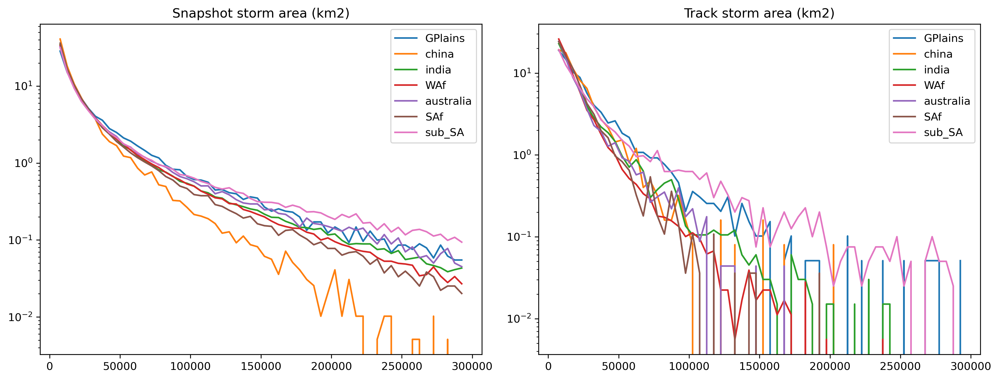

In [14]:
f= plt.figure(figsize=(13,5), dpi=300)
ax = f.add_subplot(121)
for regs in MREGIONS.keys():
   
    pick = snapdics[regs]

    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['area'], bins=np.arange(5000,300000,5000))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    ax.plot(mid_bin,hist_freq, label=regs)
    
    ax.set_yscale('log')
plt.legend()
ax.set_title('Snapshot storm area (km2)')
#     subpick = pick[pick['precipitation_max']>10]
#     hist_freq, hist_count, bin_edge = u_stats.histo_frequency(subpick['area'], bins=np.arange(5000,300000,5000))
#     mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
#     ax.plot(mid_bin,hist_freq, label='MCS snapshot, pmax>10mm/h')
ax = f.add_subplot(122)
for regs in MREGIONS.keys():    
    
    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(rdics[regs]['pf_area1'], bins=np.arange(5000,300000,5000))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    ax.plot(mid_bin,hist_freq, label=regs)
    
#     hist_freq, hist_count, bin_edge = u_stats.histo_frequency(rdics[regs]['core_area'], bins=np.arange(5000,300000,5000))
#     mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
#     ax.plot(mid_bin,hist_freq, label='MCS track, core_area', color='brown')
    ax.set_yscale('log')
plt.legend()
ax.set_title('Track storm area (km2)')
    #f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_mint_dist.jpg')
plt.tight_layout()
    #f.savefig(cnst.FIGS+'/LMCS/trackVSsnapshot/australia_trackVSsnapshot_area_histo.jpg')

In [15]:
for ids, regs in enumerate(MREGIONS.keys()):
    
    months = MREGIONS[regs][4]
    dat = snapdics[regs]

#     if ids>=4: 
#         posi = (dat['era_precip'] < 0.1) # & (((dat['direction']>=180) & (dat['ushear100m_650']>0)) | ((dat['direction']<=180) & (dat['ushear100m_650']<0)))# & ((dat['utc_month']>=months[0]) | (dat['utc_month']<=months[1]))
#     else:
#         posi = (dat['era_precip'] < 0.1)# & (((dat['direction']>=180) & (dat['ushear100m_650']>0)) | ((dat['direction']<=180) & (dat['ushear100m_650']<0)))#  & ((dat['utc_month']>=months[0]) & (dat['utc_month']<=months[1])) 
#     if ids>=4: 
#         posi = (dat['era_precip'] < 0.1)  & ((dat['utc_month']>=months[0]) | (dat['utc_month']<=months[1]))
#     else:
#         posi = (dat['era_precip'] < 0.1)  & ((dat['utc_month']>=months[0]) & (dat['utc_month']<=months[1])) 
        
#     dat = dat[posi]
        
#     if ids in [0,1,5,6]: 
#         posi = (dat['era_precip'] < 0.1)  & ((dat['direction']>=180) & (dat['ushear925_650'] >= 0))
#     else:
#         posi = (dat['era_precip'] < 0.1) & ((dat['direction']<=180) & (dat['ushear925_650'] <= 0))  
        
#     dat = dat[posi]
    
    if ids>=4: 
        posi = (dat['era_precip'] < 1)  & ((dat['month']>=months[0]) | (dat['month']<=months[1])) #& (dat['precipitation_max']>=5)
    else:
        posi = (dat['era_precip'] < 1)  & ((dat['month']>=months[0]) & (dat['month']<=months[1])) #& (dat['precipitation_max']>=5)

    #posi = (dat['era_precip'] < 1)  & ((dat['month']>=months[0]) & (dat['month']<=months[1])) #& (dat['precipitation_max']>=5)

    snapdics[regs] = dat[posi]

In [16]:
print(list(np.unique(snapdics['australia']['month'])))

[1, 2, 11, 12]


In [17]:
print(np.max(snapdics['WAf']['era_precip']))

0.999979383777827


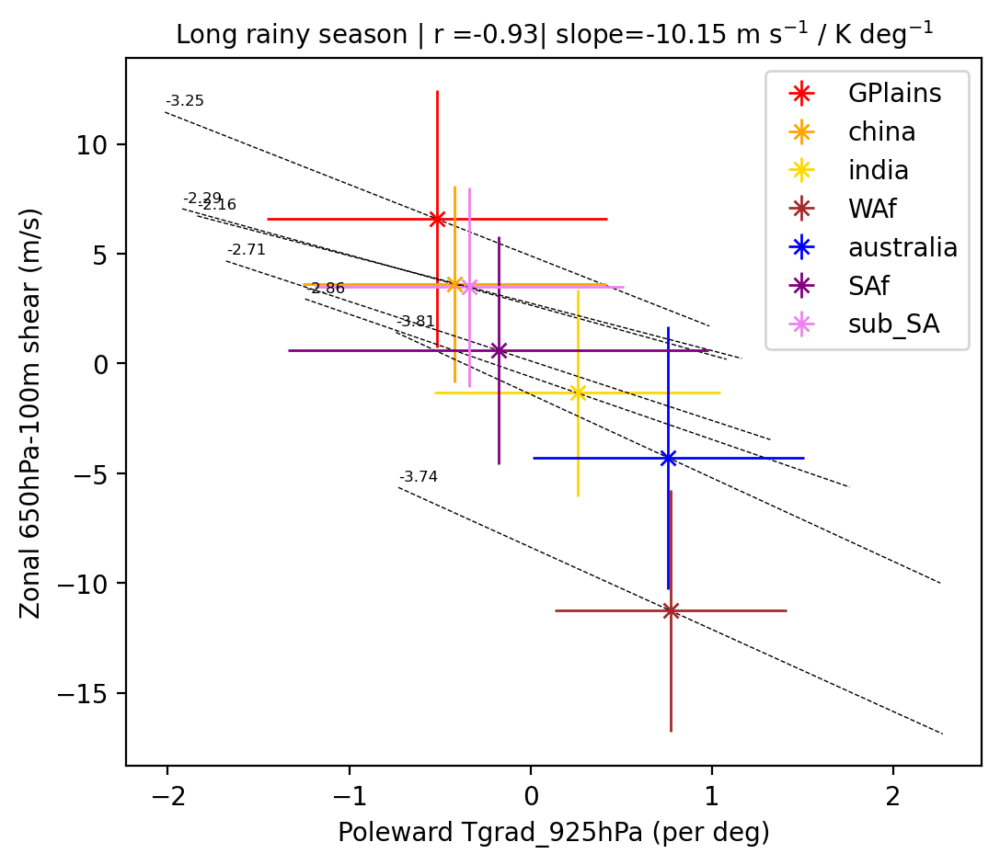

In [18]:
f = plt.figure(figsize=(6,5), dpi=200)
ax = f.add_subplot(111)

colors = ['red', 'orange', 'gold', 'brown', 'blue', 'purple', 'violet']
tgrad_list = []
shear_list = []
for ids, regs in enumerate(MREGIONS.keys()):
    var2 = 'ushear100m_650'
    var1 = 'tgrad925'
    
    dat = snapdics[regs]
    
    x = dat[var1]
    y = dat[var2]


    if ids >= 4:
        x = x*-1
        
    #ax.set_ylim(-1.5,1.5)
        
    ax.scatter(np.mean(x), np.mean(y), color=colors[ids], marker='', s=1)
    plt.errorbar(np.mean(x), np.mean(y), yerr=np.std(y), xerr=np.std(x), fmt="x", color=colors[ids], linewidth=1, label=regs)
    pf, intercept, rval, p, std_err = stats.linregress(x, y)
    xer = np.arange(np.mean(x)-1.5,np.mean(x)+2) #np.arange(np.percentile(x,0.4), np.percentile(x,0.6))
    yer = intercept+pf*xer
    plt.plot(xer, yer, color='k', linestyle='dashed', linewidth=0.5)
    plt.text(xer[0], yer[0]+0.3, str(np.round(pf,2)), fontsize=6)
    tgrad_list.append(np.mean(x))
    shear_list.append(np.mean(y))
    ax.set_xlabel('Poleward Tgrad_925hPa (per deg)')
    ax.set_ylabel('Zonal 650hPa-100m shear (m/s)')
pf, intercept, rval, p, std_err = stats.linregress(tgrad_list, shear_list)
plt.title('Long rainy season | r ='+ str(np.round(rval,2))+'| slope='+str(np.round(pf,2))+' m s$^{-1}$ / K deg$^{-1}$', fontsize=10)
plt.legend()
#f.savefig(cnst.FIGS+'/LMCS/ERA5_shear_profiles/scatter_tgrad_shear_regressionCheck.jpg')

Text(0.5, 1.0, 'sub_SA Pmax')

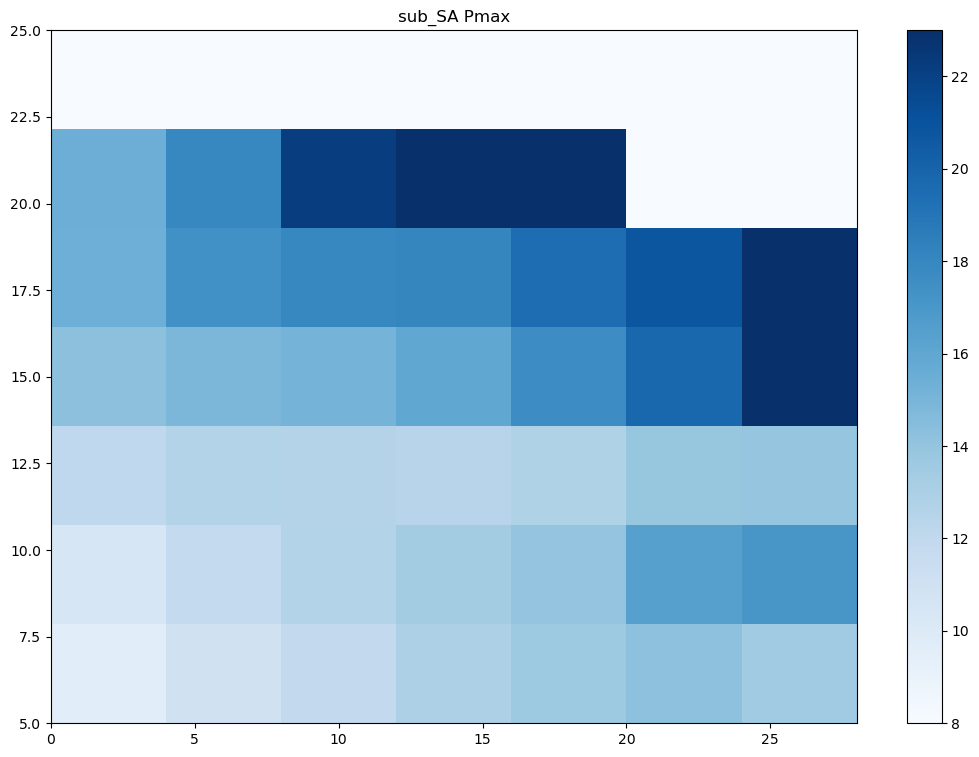

In [15]:
f= plt.figure(figsize=(13,9), dpi=100)
ax = f.add_subplot(111)


tlist = []
slist = []
plist = []

rstack = []
cstack = []

for ids, regs in enumerate(MREGIONS.keys()):
    
#     if regs in ['WAf', 'india', 'australia']:
#         continue
    
    pick = snapdics[regs]
    tbin = np.linspace(5,25,8)
    #tbin = np.linspace(5,65, 8)
    sbin = np.linspace(0,28,8)
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear925_650'].values.astype(np.float64)
    xxtc = pick['tcwv'].values
    xxtc = pick['q925'].values*1000
    xxch = pick['precipitation_max'].values
    
    if ids in [2,3,4]:
        xxu2 = xxu2*-1
    
    tlist.extend(xxtc)
    slist.extend(xxu2)
    plist.extend(xxch)
    
   # ipdb.set_trace()
    
    ret = binned_statistic_2d(slist, tlist, plist, statistic=func1, bins=testbins)
    count = binned_statistic_2d(slist, tlist, plist, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)
    
    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<5] = 0
    
    if ids == 0:
        rstack = dd
    else:
        rstack += dd
        
rstack = rstack / len(MREGIONS.keys())

mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='Blues', vmin=8, vmax=23) #vmax=p2-1, vmin=0.5  ##p2-1
plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
plt.colorbar(mp)
plt.title(regs+' Pmax')

In [19]:
months_n = (8,8)
months_s = (2,2)

 
MREGIONS = {
 'GPlains' : [[-100,-90,32,47], 'nam', -6, (1,7), months_n, (1,12)], # # 18  
 'china' : [[105,115,25,40], 'asia', 8 , (1,7), months_n, (1,12)], # 4
 'india' : [[70,90, 5,30], 'asia', 5, (1,7), months_n, (1,12)], # 7
 'WAf' : [[-18,25,4,25], 'spac', 0, (1,7), months_n, (1,12)], # last is hourly offset to UCT # 12    # [-18,25,4,25]
 'australia' : [[120,140,-23, -11], 'asia', 9, (11,3),months_s, (1,12)], # 3
 'SAf' : [[20,35, -35,-15], 'spac', 2, (9,12), months_s, (11,3)], # 10
 'sub_SA' : [[-68,-47, -40, -20.5], 'spac', -4, (11,3), months_s, (1,12)] , # 16
# 'trop_SA' : [[-75, -50, -20, -5], 'spac', -5, (1,12), (1,12), (1,12)], # 17


}

snapdics = {}
for regs in MREGIONS.keys():
    for ids, y in enumerate(range(2000,2021)):
        #'ipdb.set_trace()
        try:
            test = pd.read_csv(glob.glob('/media/ck/LStorage/global_water/MCS_5000km2_tables/ERA5_added_12LT/'+regs+'/'+str(y)+'*.csv')[0])
        except:
            ipdb.set_trace()
    #      
        if ids == 0:
            test2 = pd.DataFrame(test)
        else :
            test2 = pd.concat([test2, test])
            
    test2 = test2[test2['precipitation_max']>=2]
    snapdics[regs] = test2
    
for ids, regs in enumerate(MREGIONS.keys()):
    
    months = MREGIONS[regs][4]
    dat = snapdics[regs]
  
    
#     if ids>=4: 
#         posi = (dat['era_precip'] < 1)  & ((dat['month']>=months[0]) | (dat['month']<=months[1])) #& (dat['precipitation_max']>=5)
#     else:
#         posi = (dat['era_precip'] < 1)  & ((dat['month']>=months[0]) & (dat['month']<=months[1])) #& (dat['precipitation_max']>=5)

    posi = (dat['era_precip'] < 1)  & ((dat['month']>=months[0]) & (dat['month']<=months[1])) #& (dat['precipitation_max']>=5)

    snapdics[regs] = dat[posi]
    


In [20]:
print(list(np.unique(snapdics['australia']['month'])))

[2]


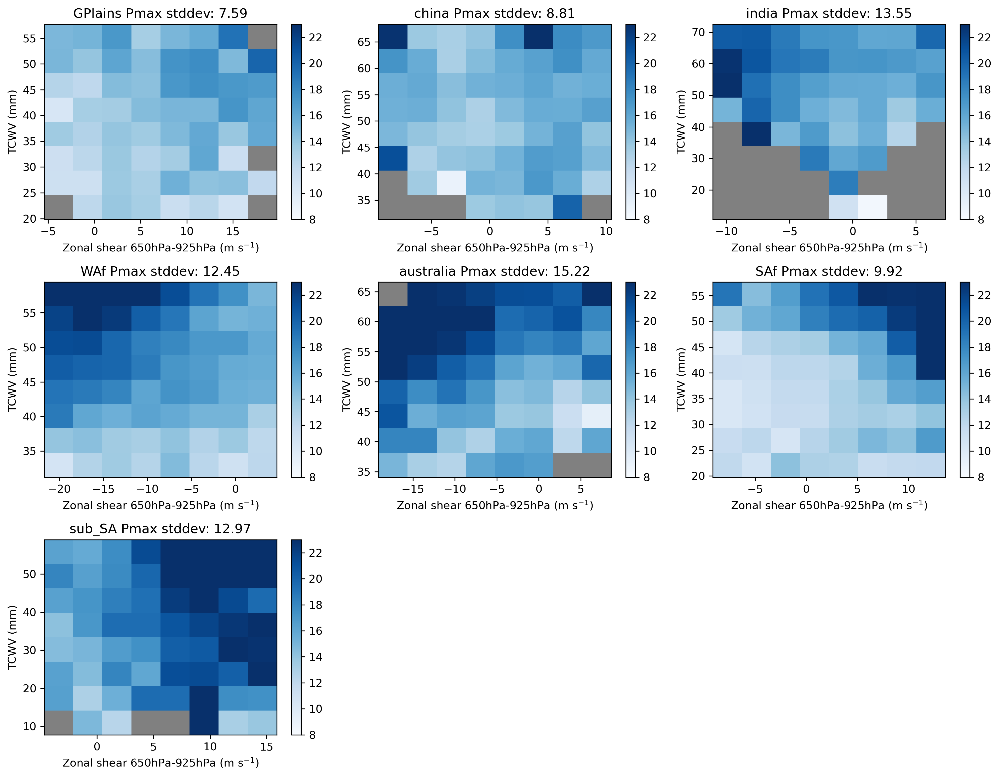

In [21]:
f= plt.figure(figsize=(13,10), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    pick = pick[pick['precipitation_max']>=5]
#     tbin = np.linspace(10,20,15)
#     #tbin = np.linspace(10,70,15)
#     sbin = np.linspace(-18,18,15)

    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],1), np.nanpercentile(pick['ushear100m_650'],99),9)
    tbin = np.linspace(np.nanpercentile(pick['tcwv'],1), np.nanpercentile(pick['tcwv'],99),9)
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    xxtc = pick['tcwv'].values
    #xxtc = pick['q925'].values*1000
    xxch = pick['precipitation_max'].values
    
   # ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<5] = np.nan

    mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='Blues', vmin=8, vmax=23) #vmax=p2-1, vmin=0.5  ##p2-1
    plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
    plt.colorbar(mp)
    plt.title(regs+' Pmax stddev: '+str(np.round(np.std(xxch),2)))
    
    ax.set_ylabel('TCWV (mm)')
    ax.set_xlabel(r'Zonal shear 650hPa-925hPa (m s$^{-1}$)')
    
    ax.set_facecolor('grey')
plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/2dbins_pmax_TCWV_DYAMOND_100mshear.jpg')

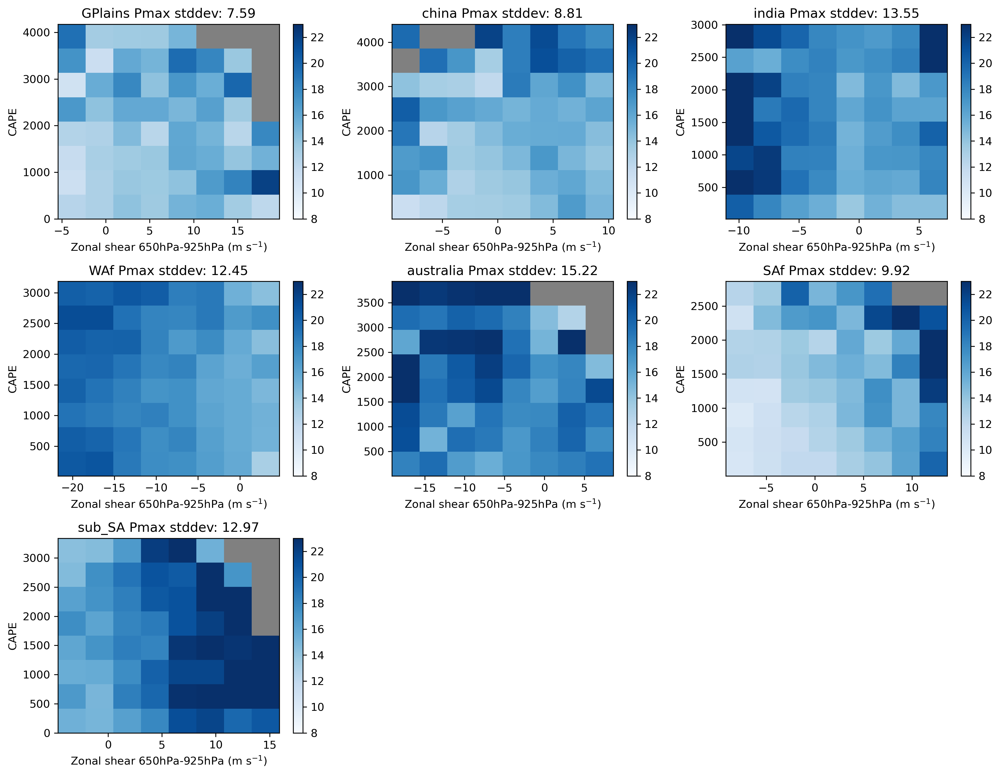

In [18]:
f= plt.figure(figsize=(13,10), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    pick = pick[pick['precipitation_max']>=5]
#     tbin = np.linspace(10,20,15)
#     #tbin = np.linspace(10,70,15)
#     sbin = np.linspace(-18,18,15)

    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],1), np.nanpercentile(pick['ushear100m_650'],99),9)
    tbin = np.linspace(np.nanpercentile(pick['cape'],1), np.nanpercentile(pick['cape'],99),9)
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    xxtc = pick['cape'].values
    #xxtc = pick['q925'].values*1000
    xxch = pick['precipitation_max'].values
    
   # ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<5] = np.nan

    mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='Blues', vmin=8, vmax=23) #vmax=p2-1, vmin=0.5  ##p2-1
    plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
    plt.colorbar(mp)
    plt.title(regs+' Pmax stddev: '+str(np.round(np.std(xxch),2)))
    
    ax.set_ylabel('CAPE')
    ax.set_xlabel(r'Zonal shear 650hPa-925hPa (m s$^{-1}$)')
    
    ax.set_facecolor('grey')
plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/2dbins_pmax_TCWV_DYAMOND_100mshear.jpg')

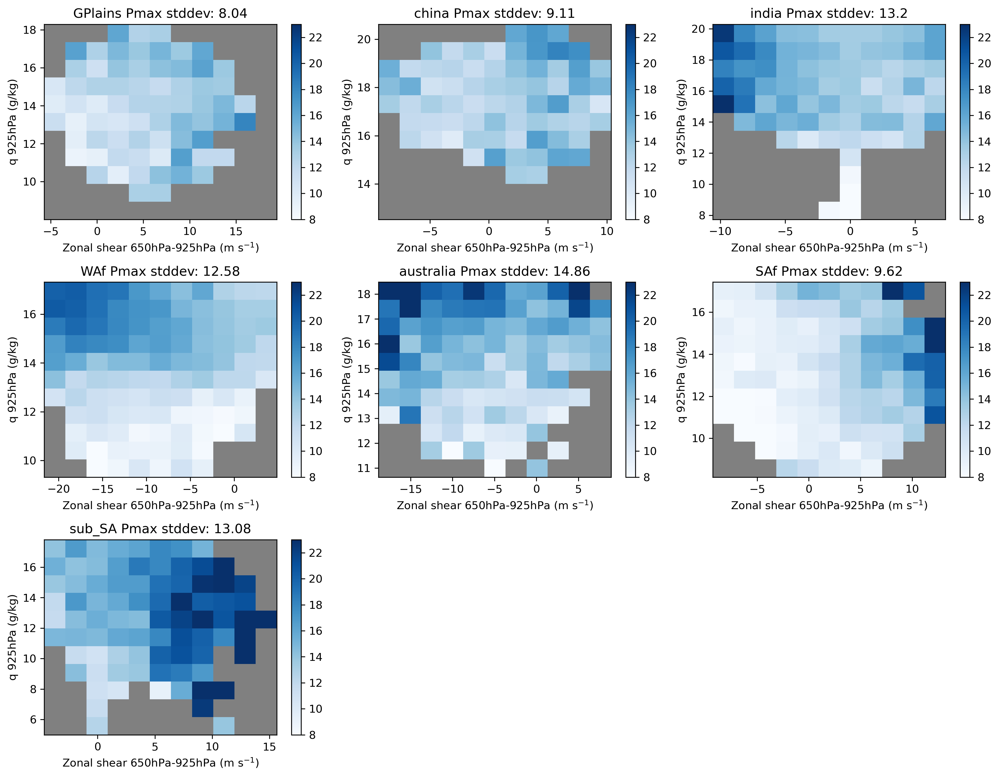

In [94]:
f= plt.figure(figsize=(13,10), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    pick = pick[pick['precipitation_max']>=2]
#     tbin = np.linspace(10,20,15)
#     #tbin = np.linspace(10,70,15)
#     sbin = np.linspace(-18,18,15)

    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],1), np.nanpercentile(pick['ushear100m_650'],99),12)
    tbin = np.linspace(np.nanpercentile(pick['q925']*1000,1), np.nanpercentile(pick['q925']*1000,99),12)
    #tbin = np.linspace(np.nanpercentile(pick['tcwv'],1), np.nanpercentile(pick['tcwv'],99),12)
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    #xxtc = pick['tcwv'].values
    xxtc = pick['q925'].values*1000
    xxch = pick['precipitation_max'].values
    
   # ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<15] = np.nan

    mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='Blues', vmin=8, vmax=23) #vmax=p2-1, vmin=0.5  ##p2-1
    plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
    plt.colorbar(mp)
    plt.title(regs+' Pmax stddev: '+str(np.round(np.std(xxch),2)))
    
    ax.set_ylabel('q 925hPa (g/kg)')
    ax.set_xlabel(r'Zonal shear 650hPa-925hPa (m s$^{-1}$)')
    
    ax.set_facecolor('grey')
plt.tight_layout()
#f.savefig(cnst.FIGS+'/LMCS/2dbins_pmax_q925_DYAMOND_100mshear.jpg')

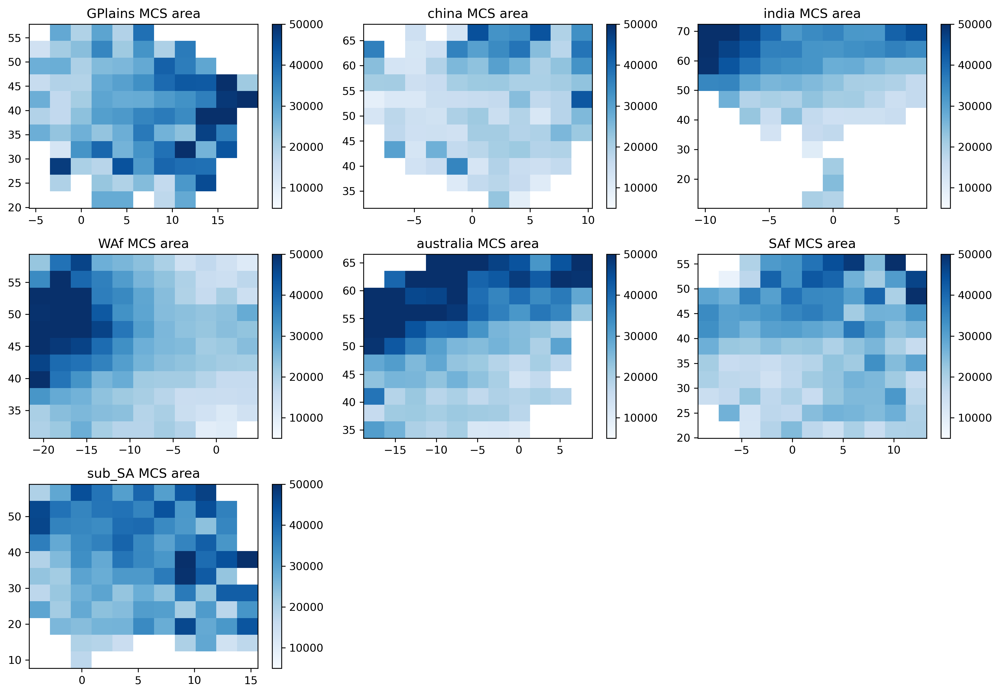

In [29]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    pick = pick[pick['precipitation_max']>=2]
#     tbin = np.linspace(5,25,15)
#     #tbin = np.linspace(10,65,15)
#     sbin = np.linspace(-20,15,15)
    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],1), np.nanpercentile(pick['ushear100m_650'],99),12)
    tbin = np.linspace(np.nanpercentile(pick['tcwv'],1), np.nanpercentile(pick['tcwv'],99),12)
    #ipdb.set_trace()
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    xxtc = pick['tcwv'].values
    #xxtc = pick['q925'].values*1000
    xxch = pick['area'].values
    
    #ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<10] = np.nan
    dd = np.array(dd).astype(float)
    
    
    mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='Blues', vmin=5000, vmax=50000) #vmax=p2-1, vmin=0.5  ##p2-1
    plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
    plt.colorbar(mp)
    plt.title(regs+' MCS area')
plt.tight_layout()

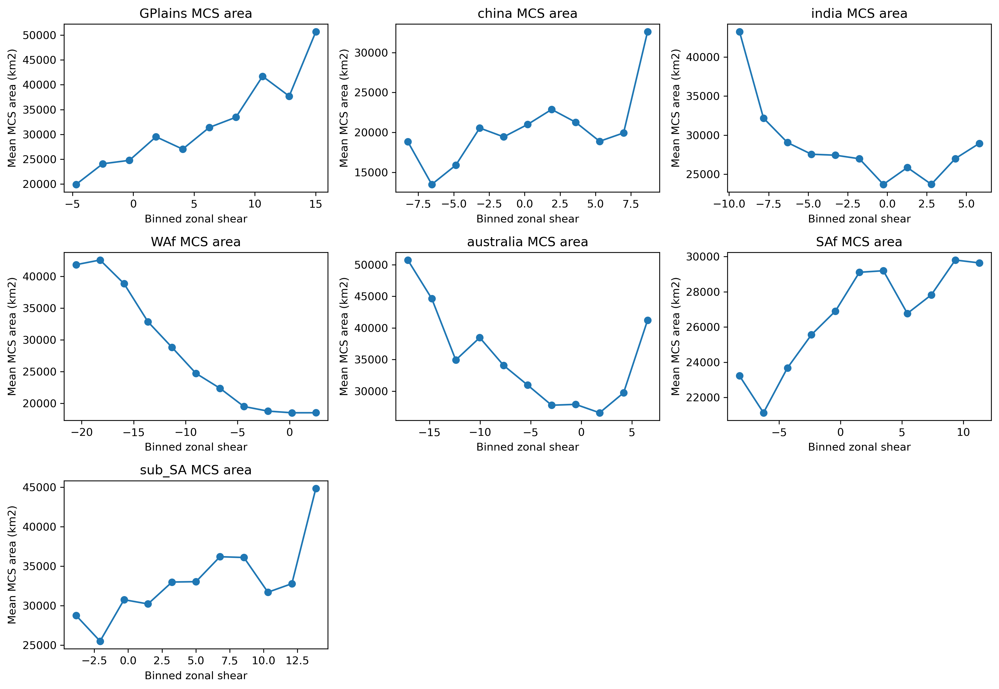

In [62]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    pick = pick[pick['precipitation_max']>=2]
#     tbin = np.linspace(5,25,15)
    
#     tbin = np.linspace(10,65,15)
#     sbin = np.linspace(-20,15,15)
    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],2), np.nanpercentile(pick['ushear100m_650'],99),12)
    
    if regs == 'india':
        start = 35
    else:
        start = np.nanpercentile(pick['tcwv'],2)
    tbin = np.linspace(start, np.nanpercentile(pick['tcwv'],99),12)
    #ipdb.set_trace()
    
#     sbin = np.percentile(pick['ushear100m_650'], np.arange(0,101,10))
#     tbin = np.percentile(pick['tcwv'], np.arange(0,101,10))
    
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    xxtc = pick['tcwv'].values
    #xxtc = pick['q925'].values*1000
    xxch = pick['area'].values
    
    #ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<10] = np.nan
    dd = np.array(dd).astype(float)
    
    pplot = np.nanmean(dd, axis=0)
    nsum = np.sum(np.isfinite(dd), axis=0)
    
    pplot[nsum<4] = np.nan

    plt.plot(testbins[0][0:-1], pplot, marker='o')
    plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
    
    plt.title(regs+' MCS area')
    plt.xlabel('Binned zonal shear')
    plt.ylabel('Mean MCS area (km2)')
plt.tight_layout()

/tmp/ipykernel_26934/3212412507.py:41: RuntimeWarning: Mean of empty slice
  pplot = np.nanmean(pp1, axis=0)
/tmp/ipykernel_26934/3212412507.py:41: RuntimeWarning: Mean of empty slice
  pplot = np.nanmean(pp1, axis=0)
/tmp/ipykernel_26934/3212412507.py:41: RuntimeWarning: Mean of empty slice
  pplot = np.nanmean(pp1, axis=0)
/tmp/ipykernel_26934/3212412507.py:41: RuntimeWarning: Mean of empty slice
  pplot = np.nanmean(pp1, axis=0)
/tmp/ipykernel_26934/3212412507.py:41: RuntimeWarning: Mean of empty slice
  pplot = np.nanmean(pp1, axis=0)
/tmp/ipykernel_26934/3212412507.py:41: RuntimeWarning: Mean of empty slice
  pplot = np.nanmean(pp1, axis=0)


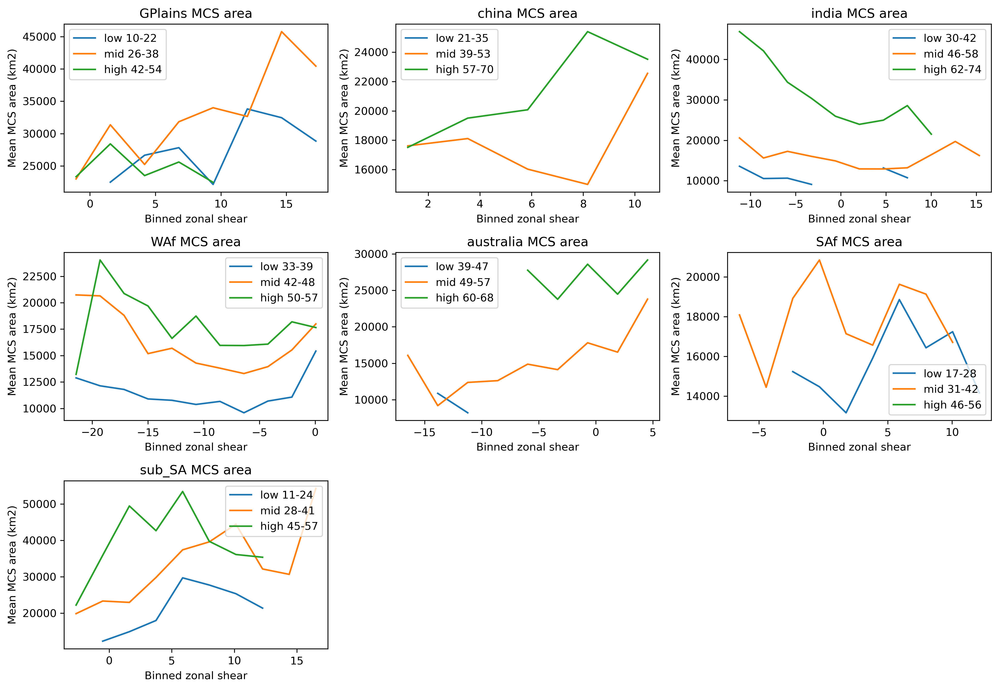

In [48]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    pick = pick[pick['pf_maxrainrate1']>=8]
    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],2), np.nanpercentile(pick['ushear100m_650'],99),12)
    
    if regs == 'india':
        start = 30
    else:
        start = np.nanpercentile(pick['tcwv'],2)
    tbin = np.linspace(start, np.nanpercentile(pick['tcwv'],99),12)
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    xxtc = pick['tcwv'].values
    #xxtc = pick['q925'].values*1000
    xxch = pick['pf_area1'].values
    
    #ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<10] = np.nan
    dd = np.array(dd).astype(float)
    

    
    for pp in [(dd[0:4], 'low', str(int(tbin[0]))+'-'+str(int(tbin[3]))), (dd[4:8], 'mid', str(int(tbin[4]))+'-'+str(int(tbin[7]))), (dd[8:12], 'high', str(int(tbin[8]))+'-'+str(int(tbin[11])))]:
        pp1 = pp[0]
        pp2 = pp[1]
        
        pplot = np.nanmean(pp1, axis=0)
        nsum = np.sum(np.isfinite(pp1), axis=0)
    
        pplot[nsum<2] = np.nan
        plt.plot(testbins[0][0:-1], pplot, label=pp2+' '+pp[2])
        plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
      
        plt.title(regs+' MCS area')
        plt.xlabel('Binned zonal shear')
        plt.ylabel('Mean MCS area (km2)')
        ax.legend()
plt.tight_layout()

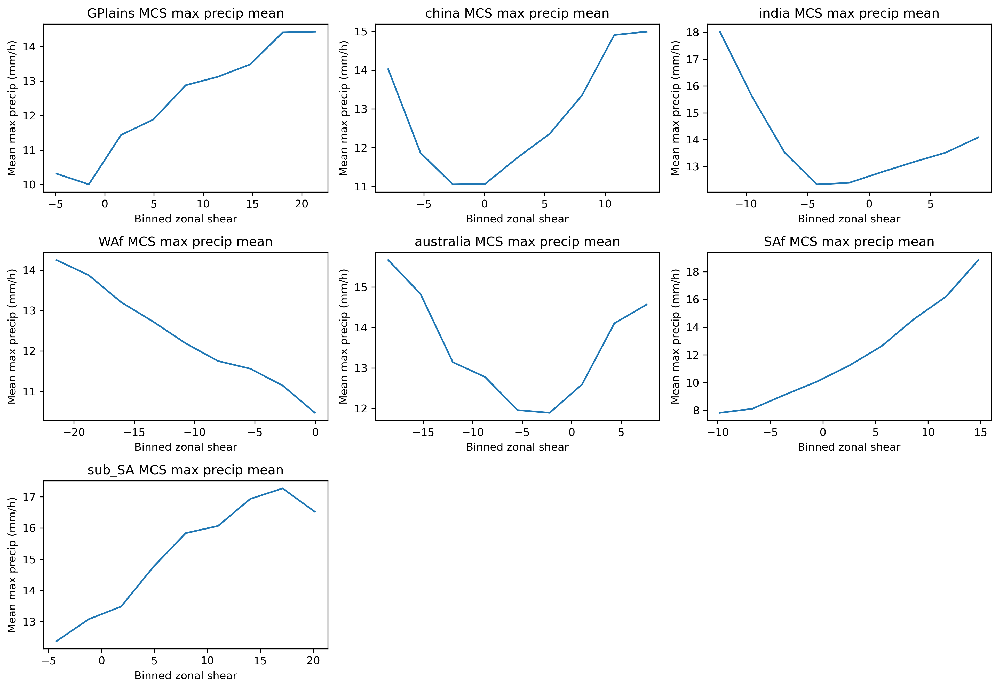

In [16]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    pick = pick[pick['precipitation_max']>=2]
#     tbin = np.linspace(5,25,15)
#     #tbin = np.linspace(10,65,15)
#     sbin = np.linspace(-20,15,15)
    sbin = np.linspace(np.nanpercentile(pick['ushear100m_650'],1), np.nanpercentile(pick['ushear100m_650'],99),10)
    tbin = np.linspace(np.nanpercentile(pick['q925']*1000,1), np.nanpercentile(pick['q925']*1000,99),15)
    #tbin = np.linspace(np.nanpercentile(pick['tcwv'],1), np.nanpercentile(pick['tcwv'],98),10)
    #ipdb.set_trace()
    testbins = [sbin,tbin]
    func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
    func2 = lambda y: np.sum(np.isfinite(y))
    func3 = lambda y: np.sum(y>1)

    xxu2 = pick['ushear100m_650'].values.astype(np.float64)
    #xxtc = pick['tcwv'].values
    xxtc = pick['q925'].values*1000
    xxch = pick['precipitation_max'].values
    
    #ipdb.set_trace()
    
    ret = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func1, bins=testbins)
    count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
    # thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

    dd=ret.statistic.T
    valid = count.statistic.T
    dd[valid<10] = np.nan
    dd = np.array(dd).astype(float)
    
    pplot = np.nanmean(dd, axis=0)

    plt.plot(testbins[0][0:-1], pplot)
    plt.title(regs+' IQR ='+str(np.round(np.nanpercentile(xxch,75)-np.nanpercentile(xxch,25),2))+'K')
    plt.colorbar(mp)
    plt.title(regs+' MCS max precip mean')
    plt.xlabel('Binned zonal shear')
    plt.ylabel('Mean max precip (mm/h)')
plt.tight_layout()

/home/ck/pythonWorkspace/proj_CEH/endgame/hist2d.py:437: RuntimeWarning: invalid value encountered in divide
  outdic['y'].append(np.sum(yvar[mask]>gt)/float(np.sum(np.isfinite(yvar[mask]))))


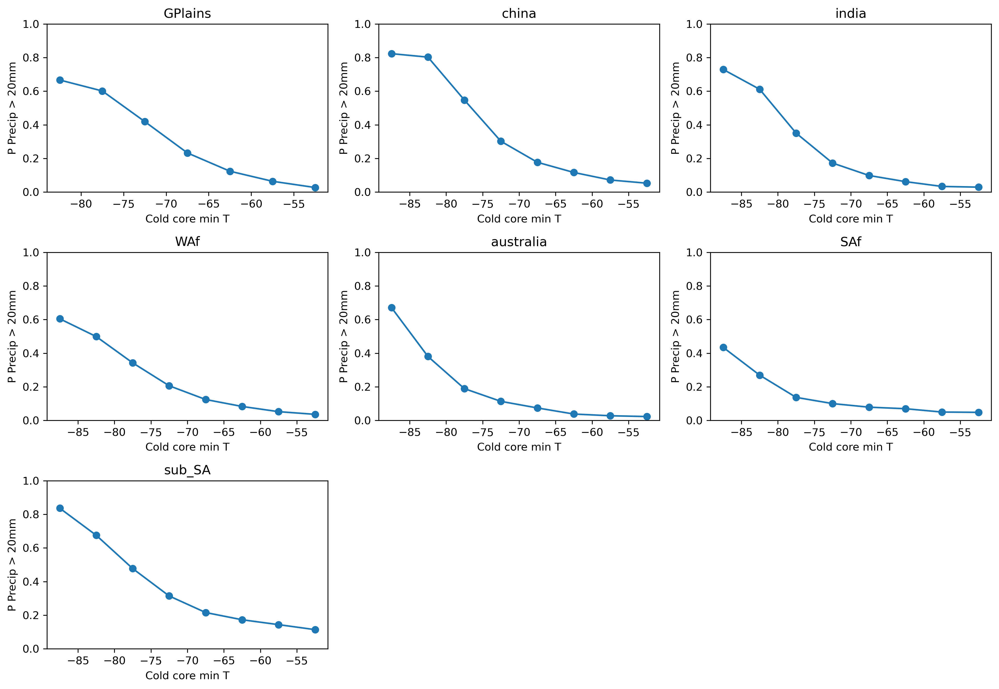

In [31]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    outdic = hist2d.var2_binning_threshold((snapdics[regs]['tmin']).values, (snapdics[regs]['precipitation_max']).values, np.arange(-90,-30,5), gt=20)
    plt.plot(outdic['xbins'], outdic['y'], '-o')
    plt.title(regs)
    ax.set_ylim(0,1)
    plt.ylabel('P Precip > 20mm')
    plt.xlabel('Cold core min T')
plt.tight_layout()
#f.savefig('/home/ck/Desktop/lmcs/20mm_precip_vs_CC_minT.jpg')

In [39]:
def moving_average(x, w):
    return np.convolve(x, np.ones(w), 'valid') / w

In [70]:
snapdics['WAf']['tmin'].values[0:50]

array([-73.34238 , -76.045105, -77.423416, -78.571014, -76.492355,
       -77.93475 , -65.6443  , -77.77777 , -76.77214 , -76.85257 ,
       -79.726944, -77.10106 , -77.78067 , -77.99899 , -74.541595,
       -77.81818 , -73.962555, -77.60681 , -78.20088 , -63.349045,
       -74.398895, -79.33783 , -79.37326 , -79.12155 , -75.99388 ,
       -73.46829 , -72.55327 , -77.966446, -69.86777 , -77.31712 ,
       -76.55371 , -73.070114, -76.81833 , -81.149124, -76.35219 ,
       -73.9854  , -75.805756, -73.0387  , -75.81842 , -78.828   ,
       -76.149994, -77.40718 , -81.321625, -72.00101 , -78.42645 ,
       -74.33008 , -77.213394, -69.92668 , -72.88521 , -70.74107 ])

GPlains PearsonRResult(statistic=-0.2394373248144724, pvalue=2.4845310993222473e-253)
china PearsonRResult(statistic=-0.11264133768884868, pvalue=2.3144400111247853e-46)
india doing minus 1
india PearsonRResult(statistic=0.03503212771848395, pvalue=5.668318772838774e-39)
WAf doing minus 1
WAf PearsonRResult(statistic=0.037673688222386224, pvalue=4.1423378607948964e-74)
australia doing minus 1
australia PearsonRResult(statistic=-0.07030443558455211, pvalue=8.727285128880705e-70)
SAf PearsonRResult(statistic=-0.10790989891965376, pvalue=8.688253813492754e-205)
sub_SA PearsonRResult(statistic=-0.13163329281977448, pvalue=4.062410031409958e-233)


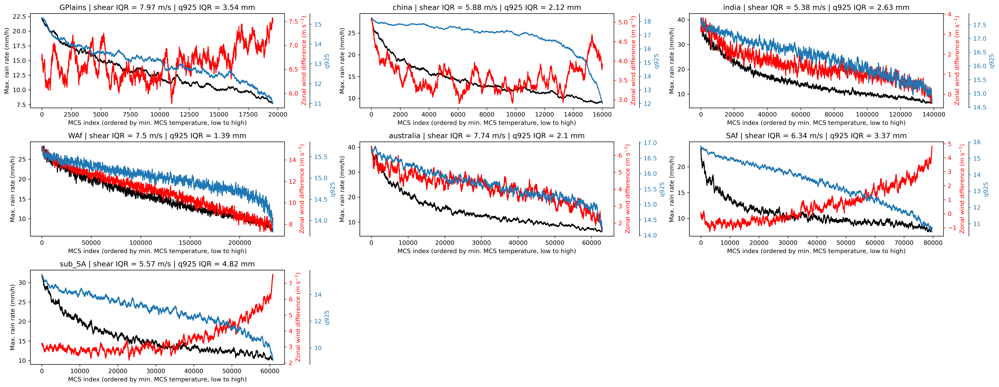

In [34]:
f= plt.figure(figsize=(23,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = snapdics[regs]
    
    obsord = obs[np.isfinite(obs['tmin']) & np.isfinite(obs['ushear100m_650'])] # & np.isfinite(obs['q925']) & np.isfinite(obs['t925'])
    inds = np.argsort(obsord['tmin'])

    minus = -20000
    pro = obsord['precipitation_max'].values[inds]#[minus::]
    sho = obsord['ushear100m_650'].values[inds]#[minus::]
    tco = obsord['q925'].values[inds]*1000#[minus::]
#     qco = obsord['q925'].values[inds]#[minus::]
#     temp = obsord['t925'].values[inds]#[minus::]
#     qupco = obsord['q650'].values[inds]#[minus::]
    
    if ids in [2,3,4]: 
        sho = sho * -1
        print(regs, 'doing minus 1')

    #tco = tco * -1
        #sho = sho * -1

    
    ax2 = ax.twinx()
    #ax3 = ax.twinx()
    ax4 = ax.twinx()

    agg = 500


    # Offset the right spine of twin2.  The ticks and label have already been
    # placed on the right by twinx above.
    #ax2.spines["right"].set_position(("axes", 1.02))
    #ax3.spines["right"].set_position(("axes", 1.1))
    ax4.spines["right"].set_position(("axes", 1.1))

    ax.plot(moving_average(pro,agg), label='pf1 area', color='k')
    #ax.invert_yaxis()
    
    plt.title(regs+' | shear IQR = '+str(np.round(np.nanpercentile(sho,75)-np.nanpercentile(sho,25),2))+' m/s' + ' | q925 IQR = '+str(np.round(np.nanpercentile(tco,75)-np.nanpercentile(tco,25),2))+' mm')

    p4, = ax4.plot(moving_average(tco,agg), label='tcwv')
    p2, = ax2.plot(moving_average(sho,agg), label='ushear', color='r')
#     if ids in [2,3,4]: 
#         print(regs, 'doing minus 1')
#         ax2.invert_yaxis()
    #p3, = ax3.plot(moving_average(qco,500), label='q925', color='purple')
    #p4, = ax4.plot(moving_average(temp,500), label='t925', color='orange')

    ax2.yaxis.label.set_color(p2.get_color())
    #ax3.yaxis.label.set_color(p3.get_color())
    ax4.yaxis.label.set_color(p4.get_color())

    tw = moving_average(tco,agg)
    twd = tw[1::]-tw[0:-1]
    sw = moving_average(sho,agg)
    swd = sw[1::]-sw[0:-1]

    print(regs, stats.pearsonr(twd,swd))

    ax.set_ylabel('Max. rain rate (mm/h)')
    ax2.set_ylabel('Zonal wind difference (m s$^{-1}$)')
    ax4.set_ylabel('q925')


    ax2.tick_params(axis='y', colors=p2.get_color())
    #ax3.tick_params(axis='y', colors=p3.get_color() )
    ax4.tick_params(axis='y', colors=p4.get_color())

    
    ax.set_xlabel('MCS index (ordered by min. MCS temperature, low to high)')

    
plt.tight_layout()
#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/minT_ordered_maxRain_shear_q925.jpg')

GPlains PearsonRResult(statistic=-0.37550437179790414, pvalue=0.0)
china PearsonRResult(statistic=-0.12510765755610448, pvalue=7.410225258449827e-57)
india doing minus 1 shear
india PearsonRResult(statistic=-0.04353135667732585, pvalue=3.1136839250143622e-59)
WAf doing minus 1 shear
WAf PearsonRResult(statistic=0.22223995760380527, pvalue=0.0)
australia doing minus 1 shear
australia PearsonRResult(statistic=0.06211578153433846, pvalue=7.552895368603349e-55)
SAf PearsonRResult(statistic=0.10054421694885049, pvalue=6.365418378029689e-178)
sub_SA PearsonRResult(statistic=0.19879834830625087, pvalue=0.0)


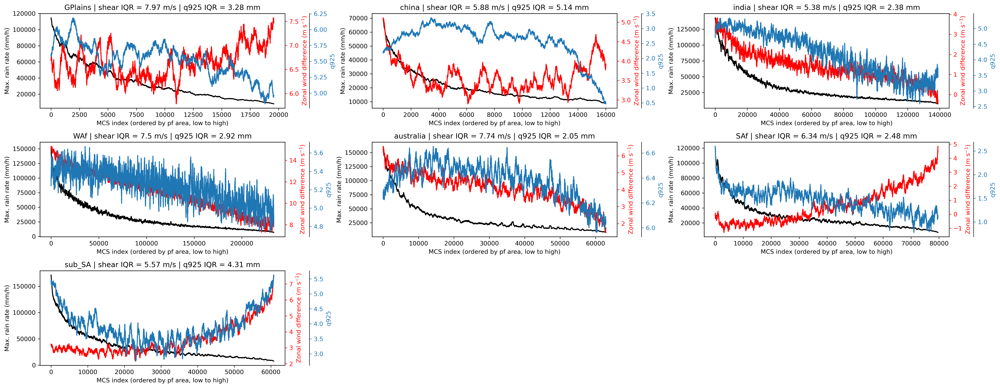

In [72]:
f= plt.figure(figsize=(23,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = snapdics[regs]
    
    obsord = obs[np.isfinite(obs['tmin']) & np.isfinite(obs['ushear100m_650'])] # & np.isfinite(obs['q925']) & np.isfinite(obs['t925'])
    inds = np.argsort(obsord['tmin'])

    minus = -20000
    pro = obsord['area'].values[inds]#[minus::]
    sho = obsord['ushear100m_650'].values[inds]#[minus::]
    tco = obsord['t2m'].values[inds]-obsord['t925'].values[inds]
#     qco = obsord['q925'].values[inds]#[minus::]
#     temp = obsord['t925'].values[inds]#[minus::]
#     qupco = obsord['t2m'].values[inds]-obsord['t925'].values[inds]#[minus::]

#     qupco = obsord['t2m'].values[inds]-obsord['t925'].values[inds]
    
    if ids in [2,3,4]: 
        sho = sho * -1
        print(regs, 'doing minus 1 shear')
        
#     if ids in [4,5,6]: 
#         tco = tco * -1
#         print(regs, 'doing minus 1 shgrad')

    #tco = tco * -1
        #sho = sho * -1

    
    ax2 = ax.twinx()
    #ax3 = ax.twinx()
    ax4 = ax.twinx()

    agg = 500


    # Offset the right spine of twin2.  The ticks and label have already been
    # placed on the right by twinx above.
    #ax2.spines["right"].set_position(("axes", 1.02))
    #ax3.spines["right"].set_position(("axes", 1.1))
    ax4.spines["right"].set_position(("axes", 1.1))
    var1 = moving_average(pro,agg)
    ax.plot(var1, label='pf1 area', color='k')
    #ax.invert_yaxis()
    
    plt.title(regs+' | shear IQR = '+str(np.round(np.nanpercentile(sho,75)-np.nanpercentile(sho,25),2))+' m/s' + ' | q925 IQR = '+str(np.round(np.nanpercentile(tco,75)-np.nanpercentile(tco,25),2))+' mm')

    p4, = ax4.plot(moving_average(tco,agg), label='tcwv')
    p2, = ax2.plot(moving_average(sho,agg), label='ushear', color='r')
    
    #ax.plot(moving_average(qupco,agg), label='q925', color='purple')
#     if ids in [2,3,4]: 
#         print(regs, 'doing minus 1')
#         ax2.invert_yaxis()
    #p3, = ax3.plot(moving_average(qco,500), label='q925', color='purple')
    #p4, = ax4.plot(moving_average(temp,500), label='t925', color='orange')

    ax2.yaxis.label.set_color(p2.get_color())
    #ax3.yaxis.label.set_color(p3.get_color())
    ax4.yaxis.label.set_color(p4.get_color())

    tw = moving_average(tco,agg)
    twd = tw[1::]-tw[0:-1]
    sw = moving_average(sho,agg)
    swd = sw[1::]-sw[0:-1]
    vard = var1[1::]-var1[0:-1]


    print(regs, stats.pearsonr(twd,swd))
#     print(regs, 'humidity', stats.pearsonr(vard,twd))
#     print(regs, 'shear', stats.pearsonr(vard,swd))

    ax.set_ylabel('Max. rain rate (mm/h)')
    ax2.set_ylabel('Zonal wind difference (m s$^{-1}$)')
    ax4.set_ylabel('q925')


    ax2.tick_params(axis='y', colors=p2.get_color())
    #ax3.tick_params(axis='y', colors=p3.get_color() )
    ax4.tick_params(axis='y', colors=p4.get_color())

    
    ax.set_xlabel('MCS index (ordered by pf area, low to high)')

    
plt.tight_layout()
#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/pfarea_ordered_maxRain_shear_q925.jpg')

In [36]:
from metpy.calc import basic
from metpy.units import units
from metpy.constants import default
import mpl_axes_aligner

In [37]:
snapdics['WAf'].keys()

Index(['tcwv', 'tgrad2m', 'tgrad2m_resid', 'tgrad925', 'tgrad850', 'smgrad',
       'efgrad_acc', 'shgrad', 'shgrad_resid', 'lhgrad', 'shgrad_acc',
       'lhgrad_acc', 'q925', 'q650', 'q850', 'era_precip', 'era_precip_acc',
       'sm', 'ef_acc', 'sh_acc', 'lh_acc', 'u925', 'u650', 'v925', 'v650',
       'w925', 'w650', 'rh925', 'rh650', 't925', 't650', 't850', 'div925',
       'div850', 'div650', 'pv925', 'pv650', 'pv850', 'ushear925_650',
       'ushear850_650', 'ushear925_850', 'ushear100m_650', 'vshear925_650',
       'vshear850_650', 'vshear925_850', 'vshear100m_650', 'shear925_650',
       'shear850_650', 'shear925_850', 'shear100m_650', 'cape', 't2m',
       'Unnamed: 0', 'date', 'month', 'hour', 'minute', 'year', 'day', 'area',
       '70area', 'tmin', 'minlon', 'minlat', 'maxlon', 'maxlat', 'clon',
       'clat', 'tminlon', 'tminlat', 'tmean', 'tp1', 'tp99', 'stormID',
       'precipitation_mean', 'precipitation_max', 'precipitation_p95',
       'precipitation_p99', 'lt_hour'

GPlains PearsonRResult(statistic=-0.06163842475232101, pvalue=1.5755363978908785e-17)
china PearsonRResult(statistic=0.3045915340445121, pvalue=0.0)
india PearsonRResult(statistic=0.29035479323596325, pvalue=0.0)
WAf PearsonRResult(statistic=0.11137617156602839, pvalue=0.0)
australia doing minus 1 shgrad
australia PearsonRResult(statistic=0.17860582311476847, pvalue=0.0)
SAf doing minus 1 shgrad
SAf PearsonRResult(statistic=0.3980202801351994, pvalue=0.0)
sub_SA doing minus 1 shgrad
sub_SA PearsonRResult(statistic=0.09459565449228984, pvalue=6.800167151996487e-120)


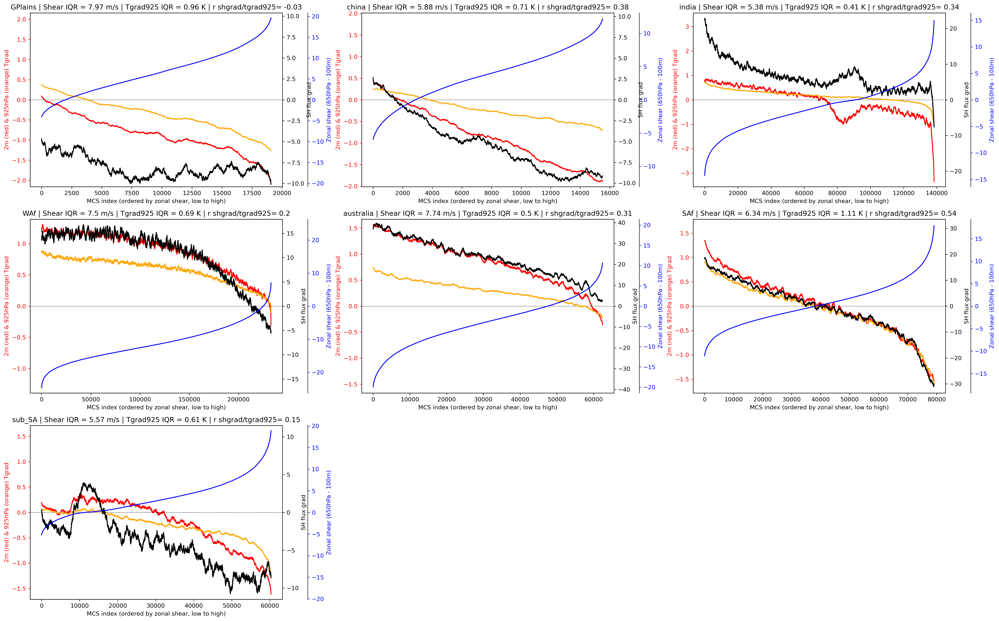

In [52]:
f= plt.figure(figsize=(24,15), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = snapdics[regs]
    
    obsord = obs[np.isfinite(obs['tmin']) & np.isfinite(obs['ushear100m_650']) & np.isfinite(obs['shgrad_resid']) ] # & np.isfinite(obs['q925']) & np.isfinite(obs['t925'])
    obsord_var = obsord['ushear100m_650']
#     if ids >= 4:
#         obsord_var = obsord_var*-1
    
    inds = np.argsort(obsord_var)

    minus = -20000
    pro = obsord['tgrad2m'].values[inds]#[minus::]
    sho = obsord['ushear100m_650'].values[inds]#[minus::]
    tco = obsord['tgrad850'].values[inds]#[minus::]
    qco = obsord['shgrad_acc'].values[inds]#[minus::]
#     temp = obsord['t925'].values[inds]#[minus::]
    qupco = obsord['t2m'].values[inds]-obsord['t925'].values[inds]#[minus::]
    
#     if ids in [2,3,4]: 
#         sho = sho * -1
#         print(regs, 'doing minus 1 shear')
        
    if ids >= 4:
        tco = tco * -1
        pro = pro * -1
        qco = qco * -1
        print(regs, 'doing minus 1 shgrad')
        
    surface_exchange = 0.05
    SH_temp = np.mean(qco) / (default.Cp_d * default.rho_d * surface_exchange)
    

    #tco = tco * -1
        #sho = sho * -1

    
    ax2 = ax.twinx()
    #ax3 = ax.twinx()
    ax4 = ax.twinx()

    agg = 1000


    # Offset the right spine of twin2.  The ticks and label have already been
    # placed on the right by twinx above.
    #ax2.spines["right"].set_position(("axes", 1.02))
    #ax3.spines["right"].set_position(("axes", 1.1))
    ax4.spines["right"].set_position(("axes", 1.1))
    var1 = moving_average(pro,agg)
    p1, = ax.plot(var1, label='2m Tgrad', color='red')
    #ax.invert_yaxis()
    
    ax.axhline(0, linestyle='dashed', color='k', linewidth=0.5)
    


    p2, = ax2.plot(moving_average(qco,agg), label='SH flux grad', color='k')
    ax.plot(moving_average(tco,agg), label='925hPa Tgrad', color='orange')
    p4, = ax4.plot(moving_average(sho,agg), label='u-shear', color='blue')
#     if ids in [2,3,4]: 
#         print(regs, 'doing minus 1')
#         ax2.invert_yaxis()
    #ax.plot(moving_average(qupco,agg), label='q925', color='purple')
    #p4, = ax4.plot(moving_average(temp,500), label='t925', color='orange')

    ax2.yaxis.label.set_color(p2.get_color())
    ax.yaxis.label.set_color(p1.get_color())
    ax4.yaxis.label.set_color(p4.get_color())

    tw = moving_average(qco,agg)
    twd = tw[1::]-tw[0:-1]
    sw = moving_average(tco,agg)
    swd = sw[1::]-sw[0:-1]
    vard = var1[1::]-var1[0:-1]
    
    plt.title(regs+' | Shear IQR = '+str(np.round(np.nanpercentile(sho,75)-np.nanpercentile(sho,25),2))+' m/s' + ' | Tgrad925 IQR = '
              +str(np.round(np.nanpercentile(tco,75)-np.nanpercentile(tco,25),2))+' K | '+'r shgrad/tgrad925= '+str(np.round(stats.pearsonr(qco,tco)[0],2)))


    print(regs, stats.pearsonr(twd,swd))
#     print(regs, 'humidity', stats.pearsonr(vard,twd))
#     print(regs, 'shear', stats.pearsonr(vard,swd))

    ax.set_ylabel('2m (red) & 925hPa (orange) Tgrad')
    ax4.set_ylabel('Zonal shear (650hPa - 100m)')
    ax2.set_ylabel('SH flux grad')

    ax.tick_params(axis='y', colors=p1.get_color())
    ax2.tick_params(axis='y', colors=p2.get_color())
    #ax3.tick_params(axis='y', colors=p3.get_color() )
    ax4.tick_params(axis='y', colors=p4.get_color())

    
    ax.set_xlabel('MCS index (ordered by zonal shear, low to high)')
    
    mpl_axes_aligner.align.yaxes(ax, 0, ax2, 0, 0.5)
    mpl_axes_aligner.align.yaxes(ax, 0, ax4, 0, 0.5)

    
plt.tight_layout()
#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/shear_ordered_tgrads_shflux.jpg')

GPlains PearsonRResult(statistic=-0.024928961017900198, pvalue=0.000678217322066298)
china PearsonRResult(statistic=0.3772870342958815, pvalue=0.0)
india PearsonRResult(statistic=0.3267374431927811, pvalue=0.0)
WAf PearsonRResult(statistic=0.17662707306123537, pvalue=0.0)
australia doing minus 1 shgrad
australia PearsonRResult(statistic=0.304509699977883, pvalue=0.0)
SAf doing minus 1 shgrad
SAf PearsonRResult(statistic=0.5257124092096623, pvalue=0.0)
sub_SA doing minus 1 shgrad
sub_SA PearsonRResult(statistic=0.15169386955946554, pvalue=1.0422889943816243e-304)


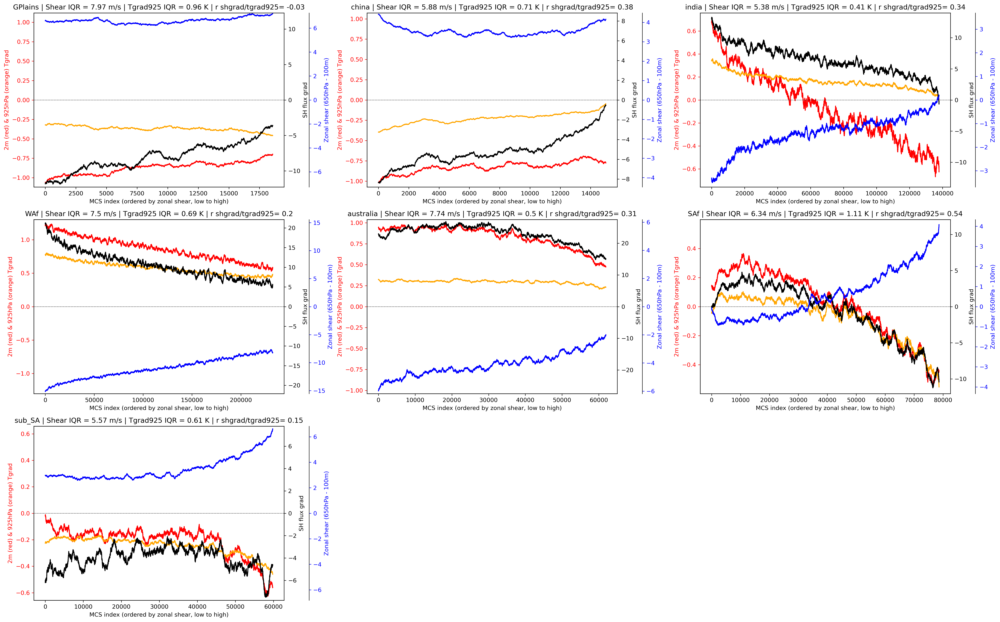

In [58]:
f= plt.figure(figsize=(24,15), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = snapdics[regs]
    
    obsord = obs[np.isfinite(obs['tmin']) & np.isfinite(obs['ushear100m_650']) & np.isfinite(obs['shgrad_resid']) ] # & np.isfinite(obs['q925']) & np.isfinite(obs['t925'])
    obsord_var = obsord['tmin']
#     if ids >= 4:
#         obsord_var = obsord_var*-1
    
    inds = np.argsort(obsord_var)

    minus = -20000
    pro = obsord['tgrad2m'].values[inds]#[minus::]
    sho = obsord['ushear100m_650'].values[inds]#[minus::]
    tco = obsord['tgrad850'].values[inds]#[minus::]
    qco = obsord['shgrad_acc'].values[inds]#[minus::]
#     temp = obsord['t925'].values[inds]#[minus::]
    qupco = obsord['t2m'].values[inds]-obsord['t925'].values[inds]#[minus::]
    
#     if ids in [2,3,4]: 
#         sho = sho * -1
#         print(regs, 'doing minus 1 shear')
        
    if ids >= 4:
        tco = tco * -1
        pro = pro * -1
        qco = qco * -1
        print(regs, 'doing minus 1 shgrad')
        
    surface_exchange = 0.05
    SH_temp = np.mean(qco) / (default.Cp_d * default.rho_d * surface_exchange)
    

    #tco = tco * -1
        #sho = sho * -1

    
    ax2 = ax.twinx()
    #ax3 = ax.twinx()
    ax4 = ax.twinx()

    agg = 1500


    # Offset the right spine of twin2.  The ticks and label have already been
    # placed on the right by twinx above.
    #ax2.spines["right"].set_position(("axes", 1.02))
    #ax3.spines["right"].set_position(("axes", 1.1))
    ax4.spines["right"].set_position(("axes", 1.1))
    var1 = moving_average(pro,agg)
    p1, = ax.plot(var1, label='2m Tgrad', color='red')
    #ax.invert_yaxis()
    
    ax.axhline(0, linestyle='dashed', color='k', linewidth=0.5)
    


    p2, = ax2.plot(moving_average(qco,agg), label='SH flux grad', color='k')
    ax.plot(moving_average(tco,agg), label='925hPa Tgrad', color='orange')
    p4, = ax4.plot(moving_average(sho,agg), label='u-shear', color='blue')

    #ax.plot(moving_average(qupco,agg), label='q925', color='purple')


    ax2.yaxis.label.set_color(p2.get_color())
    ax.yaxis.label.set_color(p1.get_color())
    ax4.yaxis.label.set_color(p4.get_color())

    tw = moving_average(qco,agg)
    twd = tw[1::]-tw[0:-1]
    sw = moving_average(tco,agg)
    swd = sw[1::]-sw[0:-1]
    vard = var1[1::]-var1[0:-1]
    
    plt.title(regs+' | Shear IQR = '+str(np.round(np.nanpercentile(sho,75)-np.nanpercentile(sho,25),2))+' m/s' + ' | Tgrad925 IQR = '
              +str(np.round(np.nanpercentile(tco,75)-np.nanpercentile(tco,25),2))+' K | '+'r shgrad/tgrad925= '+str(np.round(stats.pearsonr(qco,tco)[0],2)))


    print(regs, stats.pearsonr(twd,swd))
#     print(regs, 'humidity', stats.pearsonr(vard,twd))
#     print(regs, 'shear', stats.pearsonr(vard,swd))

    ax.set_ylabel('2m (red) & 925hPa (orange) Tgrad')
    ax4.set_ylabel('Zonal shear (650hPa - 100m)')
    ax2.set_ylabel('SH flux grad')

    ax.tick_params(axis='y', colors=p1.get_color())
    ax2.tick_params(axis='y', colors=p2.get_color())
    #ax3.tick_params(axis='y', colors=p3.get_color() )
    ax4.tick_params(axis='y', colors=p4.get_color())

    
    ax.set_xlabel('MCS index (ordered by zonal shear, low to high)')
    
    mpl_axes_aligner.align.yaxes(ax, 0, ax2, 0, 0.5)
    mpl_axes_aligner.align.yaxes(ax, 0, ax4, 0, 0.5)

    
plt.tight_layout()
#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/shear_ordered_tgrads_shflux.jpg')

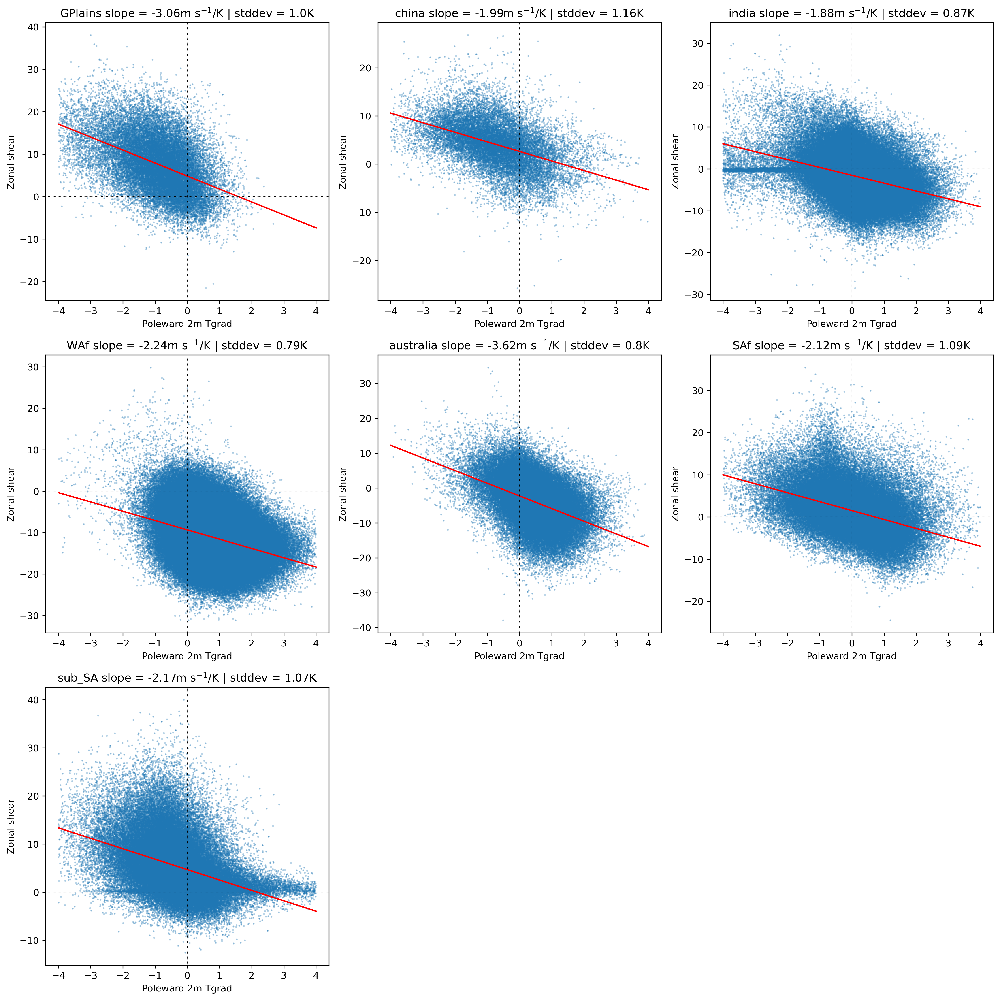

In [144]:
f= plt.figure(figsize=(15,15), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = snapdics[regs]
    tis = obs['tgrad2m']
    if ids >= 4:
        tis = tis*-1
        
    a = tis[(np.abs(obs['tgrad2m'])<=4)  & (np.abs(obs['ushear100m_650'])>=0.05)]
    b = obs['ushear100m_650'][(np.abs(obs['tgrad2m'])<=4)  & (np.abs(obs['ushear100m_650'])>=0.05)]
    
    #ipdb.set_trace()
    
    finites = np.isfinite(a) & np.isfinite(b)
    
    a = a[finites]
    b = b[finites]
    
    plt.scatter(a, b, s=1, alpha=0.3)
   
    pf, intercept, rval, p, std_err = stats.linregress(a,b)
    
    plt.plot(np.arange(-4,4.1,0.1),intercept + np.arange(-4,4.1,0.1) * pf, color='r')
    plt.xlabel('Poleward 2m Tgrad')
    plt.ylabel('Zonal shear')
    plt.title(regs+' slope = '+str(np.round(pf,2))+'m s$^{-1}$/K | stddev = '+str(np.round(np.std(a),2))+'K')
    
    ax.axhline(0, linestyle='dotted', color='k', linewidth=0.5)
    ax.axvline(0, linestyle='dotted', color='k', linewidth=0.5)
    
plt.tight_layout()

#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/lifetime_ordered_maxRain_v925_q925.jpg')

## 0.6 m/s to 2.1 m/s in shear 

Stddev tcwv 11.66679786281363
Stddev shear 6.610157113567687
Stddev tcwv 12.754890490440301
Stddev shear 4.899747683990905
Stddev tcwv 11.29900235216443
Stddev shear 4.547636881685967
Stddev tcwv 6.416987130751113
Stddev shear 5.350529241895103
Stddev tcwv 8.319994316260786
Stddev shear 6.503781721208273
Stddev tcwv 8.986568840193414
Stddev shear 5.61039237118623
Stddev tcwv 12.817905438955297
Stddev shear 5.850654840171721


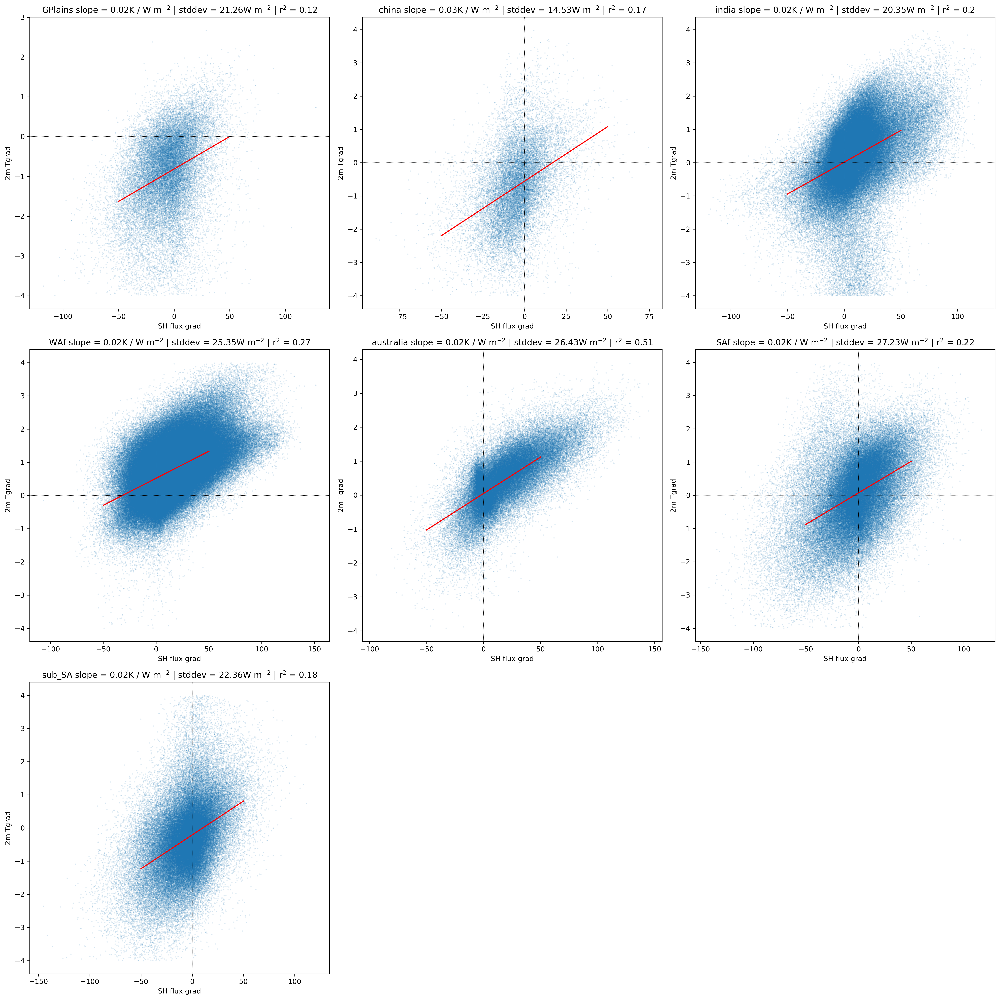

In [145]:
f= plt.figure(figsize=(20,20), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    obs = snapdics[regs]
    tis = obs['shgrad']

        
    a = tis[np.abs(obs['tgrad2m'])<=4]
    b = obs['tgrad2m'][np.abs(obs['tgrad2m'])<=4]
    
#     a = tis[(obs['tgrad2m'])<=0]
#     b = obs['tgrad2m'][(obs['tgrad2m'])<=0]
    
    if ids >= 4:
        a = a*-1
        b = b*-1
            
    print('Stddev tcwv', np.std(obs['tcwv'][np.abs(obs['tgrad2m'])<=4]))
    print('Stddev shear', np.std(obs['ushear100m_650'][np.abs(obs['tgrad2m'])<=4]))
    #print('Stddev lh', np.std(obs['lh'][np.abs(obs['tgrad2m'])<=4]))    
    
    plt.scatter(a, b, s=1, alpha=0.1)
   
    pf, intercept, rval, p, std_err = stats.linregress(a,b)
    
    plt.plot(np.arange(-50,50.1,0.1),intercept + np.arange(-50,50.1,0.1) * pf, color='r')
    plt.xlabel('SH flux grad')
    plt.ylabel('2m Tgrad')
    plt.title(regs+' slope = '+str(np.round(pf,2))+'K / W m$^{-2}$ | stddev = '+str(np.round(np.std(a),2))+'W m$^{-2}$ | r$^{2}$ = '+str(np.round(rval**2,2)))
    
    ax.axhline(0, linestyle='dotted', color='k', linewidth=0.5)
    ax.axvline(0, linestyle='dotted', color='k', linewidth=0.5)
    
plt.tight_layout()

#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/lifetime_ordered_maxRain_v925_q925.jpg')


#### 0.4-0.6 K fluctuations in the mean

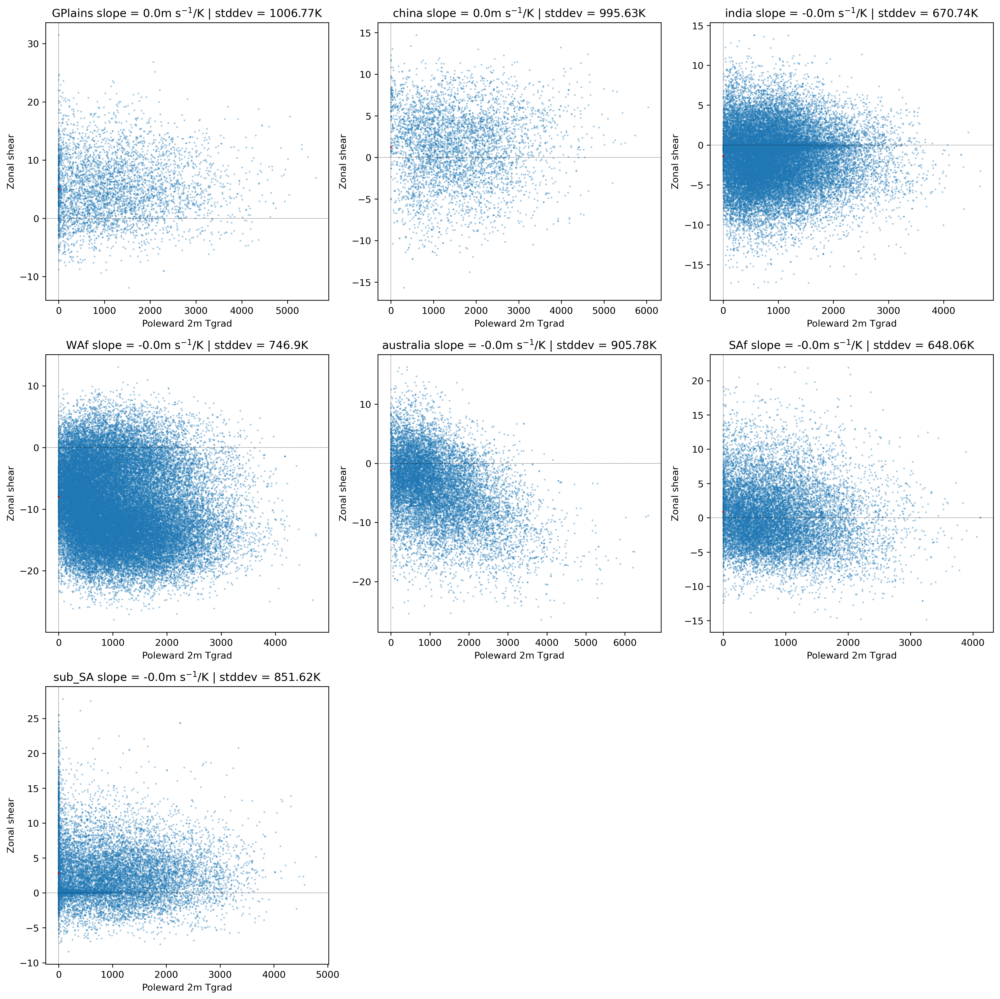

In [26]:
f= plt.figure(figsize=(15,15), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    obs = snapdics[regs]
    a = obs['cape']
    b = obs['ushear100m_650'] 
    
    #ipdb.set_trace()
    
    finites = np.isfinite(a) & np.isfinite(b)
    
    a = a[finites]
    b = b[finites]
    
    plt.scatter(a, b, s=1, alpha=0.3)
   
    pf, intercept, rval, p, std_err = stats.linregress(a,b)
    
    plt.plot(np.arange(-4,4.1,0.1),intercept + np.arange(-4,4.1,0.1) * pf, color='r')
    plt.xlabel('Poleward 2m Tgrad')
    plt.ylabel('Zonal shear')
    plt.title(regs+' slope = '+str(np.round(pf,2))+'m s$^{-1}$/K | stddev = '+str(np.round(np.std(a),2))+'K')
    
    ax.axhline(0, linestyle='dotted', color='k', linewidth=0.5)
    ax.axvline(0, linestyle='dotted', color='k', linewidth=0.5)
    
plt.tight_layout()

#f.savefig('/home/ck/DIR/cornkle/figs/LMCS/CMIP_LS3MIP/ERA5_only/lifetime_ordered_maxRain_v925_q925.jpg')

## 0.6 m/s to 2.1 m/s in shear 

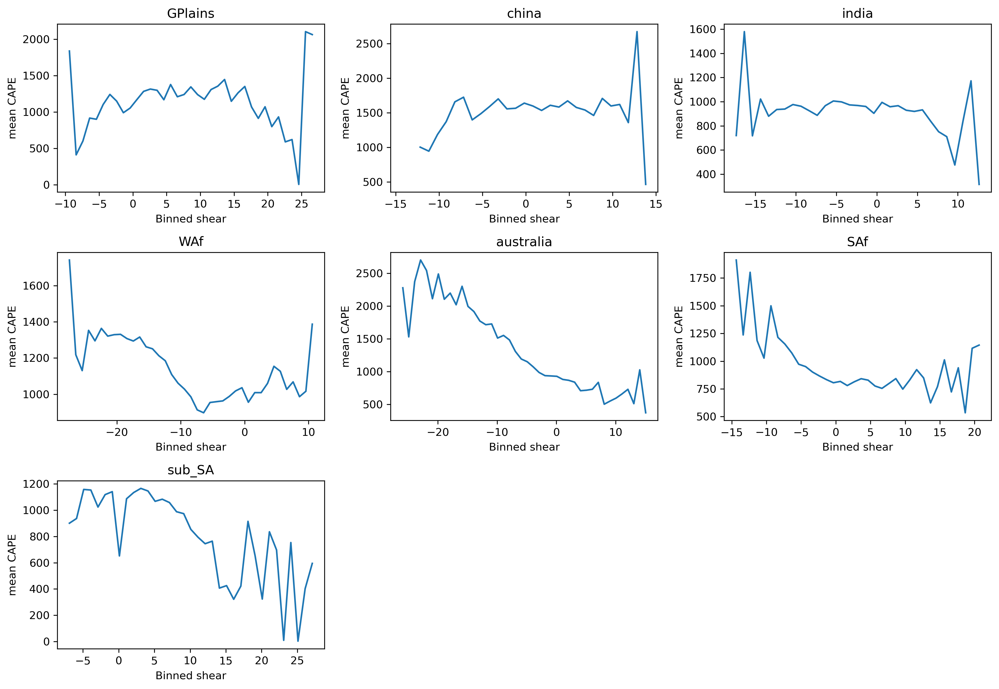

In [34]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    cp4 = hist2d.var2_binning_mean(pick['ushear100m_650'], pick['cape'], np.arange(np.min(pick['ushear100m_650']), np.max(pick['ushear100m_650']),1))
    
    plt.plot(cp4['xbins'], cp4['y'])
    
    plt.xlabel('Binned shear')
    plt.ylabel('mean CAPE')
    plt.title(regs)
plt.tight_layout()

In [171]:
from utils import u_statistics as u_stats

24
10
13
18
9
16
22


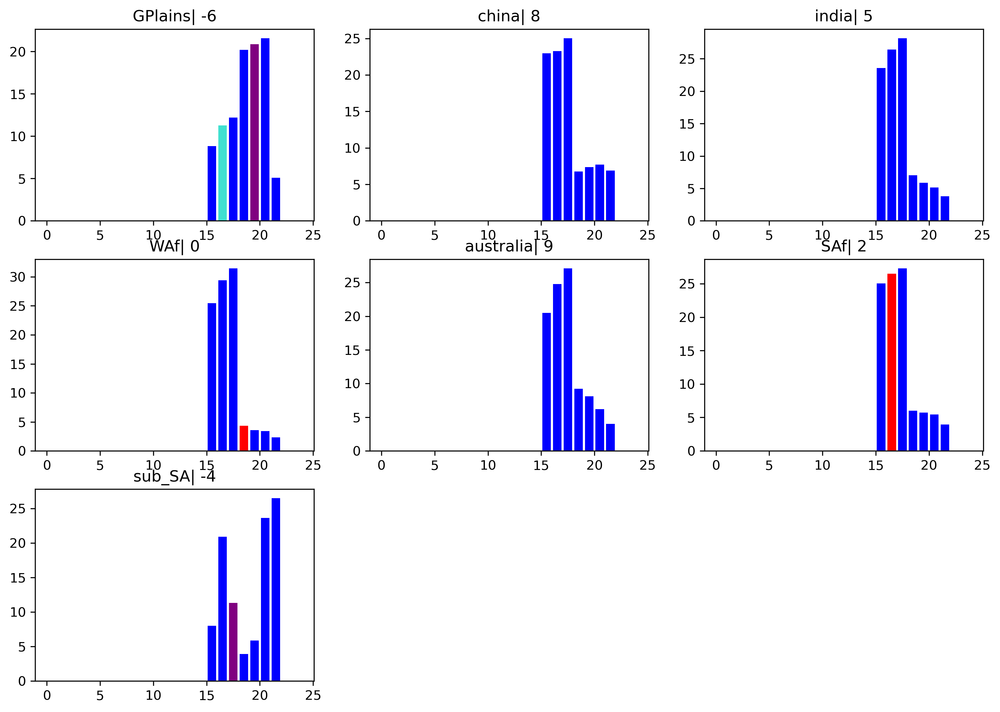

In [172]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['lt_hour'], bins=np.arange(0,25))
    #print(np.unique(pick['hour']))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    #m_bin = mid_bin - (MREGIONS[regs])[2]
    #print(mid_bin)
    colors = ['b']*24
    ispos = int(np.where(mid_bin==18.5)[0])
    secpos = int(np.where(mid_bin==13.5)[0])
    firstpos = int(np.where(mid_bin==10.5)[0])
    #minpos = ispos-(MREGIONS[regs])[2]
    #ipdb.set_trace()
    minpos = ispos-(MREGIONS[regs])[2]
    miinpos = firstpos - (MREGIONS[regs])[2]
    miiinpos = secpos - (MREGIONS[regs])[2]
    print(minpos)
    if minpos == 24:
        minpos=0
    
    colors[minpos] = 'r'  # 1800
    colors[miinpos] = 'turquoise' # 1100
    colors[miiinpos] = 'purple' # 1400
    ax.bar(mid_bin,hist_freq, align='center', color=colors)
    ax.set_title(regs + '| '+str((MREGIONS[regs])[2]))


In [ ]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['lt_hour'], bins=np.arange(0,25))
    #print(np.unique(pick['hour']))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    #m_bin = mid_bin - (MREGIONS[regs])[2]
    #print(mid_bin)
    colors = ['b']*24
    ispos = int(np.where(mid_bin==18.5)[0])
    secpos = int(np.where(mid_bin==13.5)[0])
    firstpos = int(np.where(mid_bin==10.5)[0])
    #minpos = ispos-(MREGIONS[regs])[2]
    #ipdb.set_trace()
    minpos = ispos-(MREGIONS[regs])[2]
    miinpos = firstpos - (MREGIONS[regs])[2]
    miiinpos = secpos - (MREGIONS[regs])[2]
    print(minpos)
    if minpos == 24:
        minpos=0
    
    colors[minpos] = 'r'  # 1800
    colors[miinpos] = 'turquoise' # 1100
    colors[miiinpos] = 'purple' # 1400
    ax.bar(mid_bin,hist_freq, align='center', color=colors)
    ax.set_title(regs + '| '+str((MREGIONS[regs])[2]))

In [ ]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]

    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['corecold_mintb']-273.15, bins=np.arange(-90,-40,2))
    #print(np.unique(pick['hour']))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    #m_bin = mid_bin - (MREGIONS[regs])[2]
    #print(mid_bin)
    colors = ['b']*24
#     ispos = int(np.where(mid_bin==18.5)[0])
#     secpos = int(np.where(mid_bin==13.5)[0])
#     firstpos = int(np.where(mid_bin==10.5)[0])
#     #minpos = ispos-(MREGIONS[regs])[2]
#     #ipdb.set_trace()
#     minpos = ispos-(MREGIONS[regs])[2]
#     miinpos = firstpos - (MREGIONS[regs])[2]
#     miiinpos = secpos - (MREGIONS[regs])[2]
#     print(minpos)
#     if minpos == 24:
#         minpos=0
    
#     colors[minpos] = 'r'
#     colors[miinpos] = 'turquoise'
#     colors[miiinpos] = 'purple'
    ax.bar(mid_bin,hist_freq, align='center', color=colors)
    ax.set_title(regs + '| '+str((MREGIONS[regs])[2]))
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_mint_dist.jpg')

In [ ]:
f= plt.figure(figsize=(13,9), dpi=300)
mon = []
lat = []
dat = []
for ids, regs in enumerate(MREGIONS.keys()):
    
    pick = rdics[regs]

    mon.extend(pick['utc_month'])
    lat.extend(pick['meanlat'])
    dat.extend(pick['corecold_mintb']-273.15)
    
    
tbin = np.linspace(-60,61,12)
sbin = np.linspace(1,13,12)

testbins = [sbin,tbin]
func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
func2 = lambda y: np.sum(np.isfinite(y))
func3 = lambda y: np.sum(y>1)

ax = f.add_subplot(111)

ret = binned_statistic_2d(mon, lat, dat, statistic=func1, bins=testbins)
# count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
# thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

dd=ret.statistic.T

mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='viridis', vmin=-75, vmax=-45) #vmax=p2-1, vmin=0.5  ##p2-1
plt.colorbar(mp)
plt.ylabel('Latitude')
plt.xlabel('Month')
plt.title('Minimum storm temperature')

# colours = ['r', 'k', 'b', 'y', 'g', 'w', 'r']
# for ids, regs in enumerate(MREGIONS.keys()):
    
#     pick = rdics[regs]
#     plt.scatter(pick['month'],pick['meanlat'], marker='x', s=1, color=colours[ids], label=regs)
# plt.legend(loc='upper left')
#f.savefig('/home/ck/Desktop/lmcs/latitude_mean_minT_heatmap_mixed.jpg')

Text(0.5, 0, 'Month')

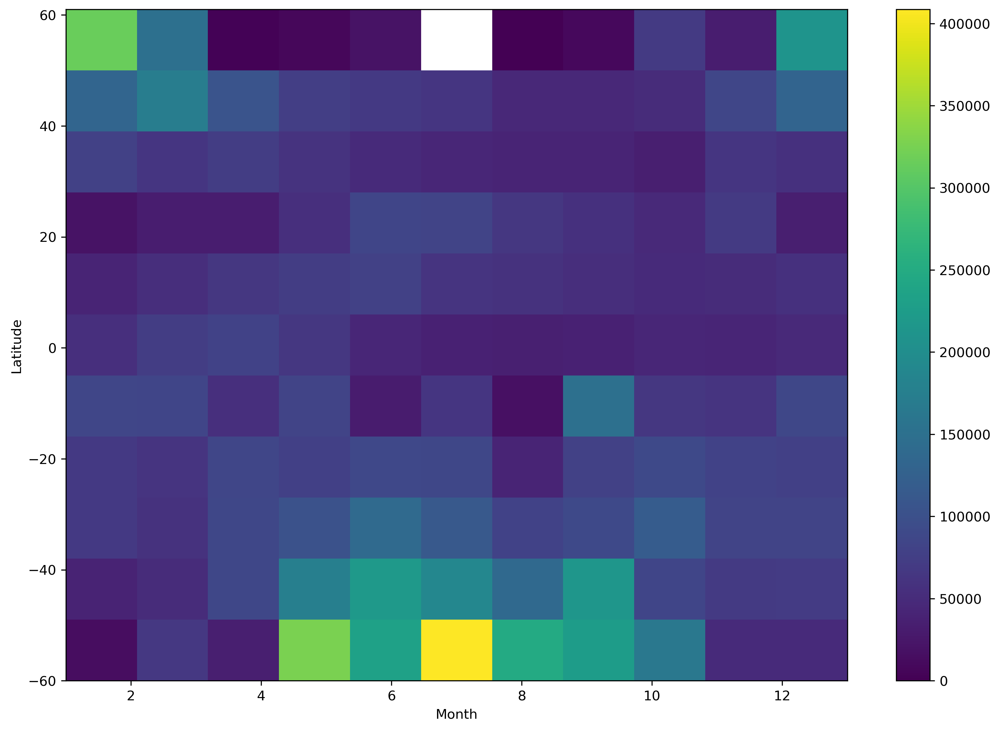

In [94]:
f= plt.figure(figsize=(13,9), dpi=300)
mon = []
lat = []
dat = []
for ids, regs in enumerate(MREGIONS.keys()):
    
    pick = rdics[regs]

    mon.extend(pick['utc_month'])
    lat.extend(pick['meanlat'])
    dat.extend(pick['core_area'])
    
    
tbin = np.linspace(-60,61,12)
sbin = np.linspace(1,13,12)

testbins = [sbin,tbin]
func1 = lambda y: np.mean(y) #np.percentile(y,95, interpolation='nearest') #np.percentile(y, 95)
func2 = lambda y: np.sum(np.isfinite(y))
func3 = lambda y: np.sum(y>1)

ax = f.add_subplot(111)

ret = binned_statistic_2d(mon, lat, dat, statistic=func1, bins=testbins)
# count = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func2, bins=testbins)
# thresh = binned_statistic_2d(xxu2, xxtc, xxch, statistic=func3, bins=testbins)

dd=ret.statistic.T

mp = plt.pcolormesh(testbins[0], testbins[1], dd, cmap='viridis') #vmax=p2-1, vmin=0.5  ##p2-1
plt.colorbar(mp)
plt.ylabel('Latitude')
plt.xlabel('Month')

# colours = ['r', 'k', 'b', 'y', 'g', 'w', 'r']
# for ids, regs in enumerate(MREGIONS.keys()):
    
#     pick = rdics[regs]
#     plt.scatter(pick['month'],pick['meanlat'], marker='x', s=1, color=colours[ids], label=regs)
# plt.legend(loc='upper left')
#f.savefig('/home/ck/Desktop/lmcs/latitude_mean_minT_heatmap_ccsArea.jpg')

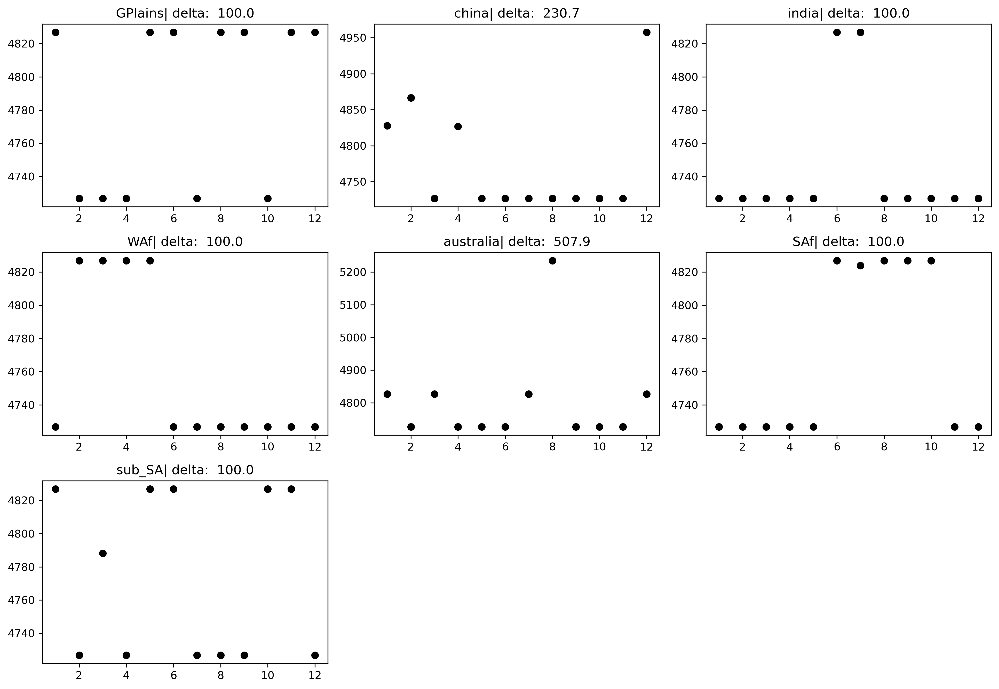

In [148]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    

    ax = f.add_subplot(3,3,ids+1)
    
    pick = snapdics[regs]
    coll = []
    for m in range(1,13):
        pickm = pick[pick['month'] == m]
        meant =  np.nanpercentile(pickm['area'].values, 0.99)
        coll.append(meant)
     
        
    ax.scatter(range(1,13),np.array(coll)-273.15, color='k')
    ax.set_title(regs + '| delta:  '+str(np.round(np.array(coll).max()-np.array(coll).min(),1)))
plt.tight_layout()
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_area.jpg')

In [ ]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    

    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    coll = []
    for m in range(1,13):
        pickm = pick[pick['month'] == m]
        meant =  pickm['meantb'].mean()
        coll.append(meant)
     
        
    ax.scatter(range(1,13),np.array(coll)-273.15, color='k')
    ax.set_title(regs + '| delta:  '+str(np.round(np.array(coll).max()-np.array(coll).min(),1)))
plt.tight_layout()
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_meant.jpg')

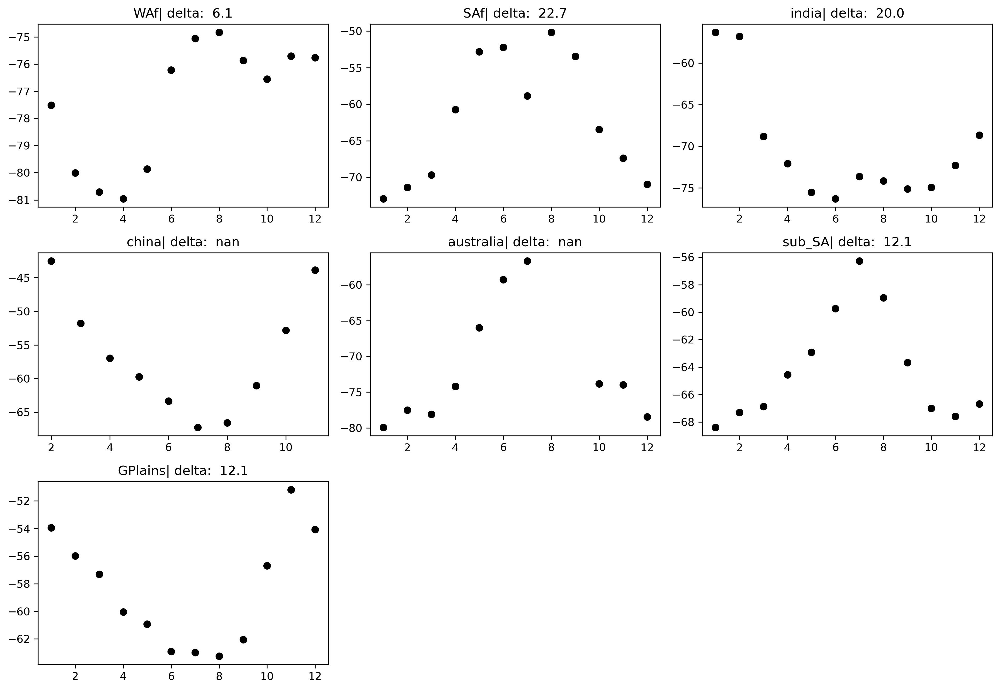

In [54]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    

    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    coll = []
    for m in range(1,13):
        pickm = pick[pick['utc_month'] == m]
        meant =  pickm['corecold_mintb'].mean()
        coll.append(meant)
     
        
    ax.scatter(range(1,13),np.array(coll)-273.15, color='k')
    ax.set_title(regs + '| delta:  '+str(np.round(np.array(coll).max()-np.array(coll).min(),1)))
plt.tight_layout()
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_mint.jpg')

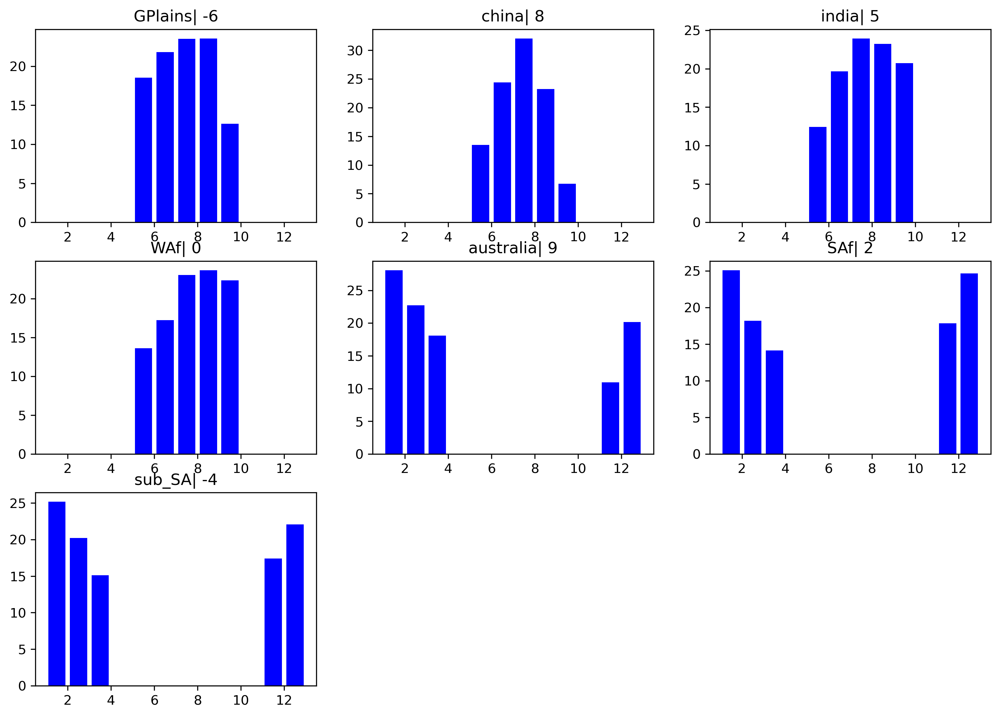

In [70]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['utc_month'], bins=np.arange(1,14))
    #print(np.unique(pick['hour']))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    #m_bin = mid_bin - (MREGIONS[regs])[2]
    #print(mid_bin)
    colors = ['b']*24
#     ispos = int(np.where(mid_bin==18.5)[0])
#     secpos = int(np.where(mid_bin==13.5)[0])
#     firstpos = int(np.where(mid_bin==10.5)[0])
#     #minpos = ispos-(MREGIONS[regs])[2]
#     #ipdb.set_trace()
#     minpos = ispos-(MREGIONS[regs])[2]
#     miinpos = firstpos - (MREGIONS[regs])[2]
#     miiinpos = secpos - (MREGIONS[regs])[2]
#     print(minpos)
#     if minpos == 24:
#         minpos=0
    
#     colors[minpos] = 'r'
#     colors[miinpos] = 'turquoise'
#     colors[miiinpos] = 'purple'
    ax.bar(mid_bin,hist_freq, align='center', color=colors)
    ax.set_title(regs + '| '+str((MREGIONS[regs])[2]))
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_stormNB.jpg')

18
16
13
10
9
22
24


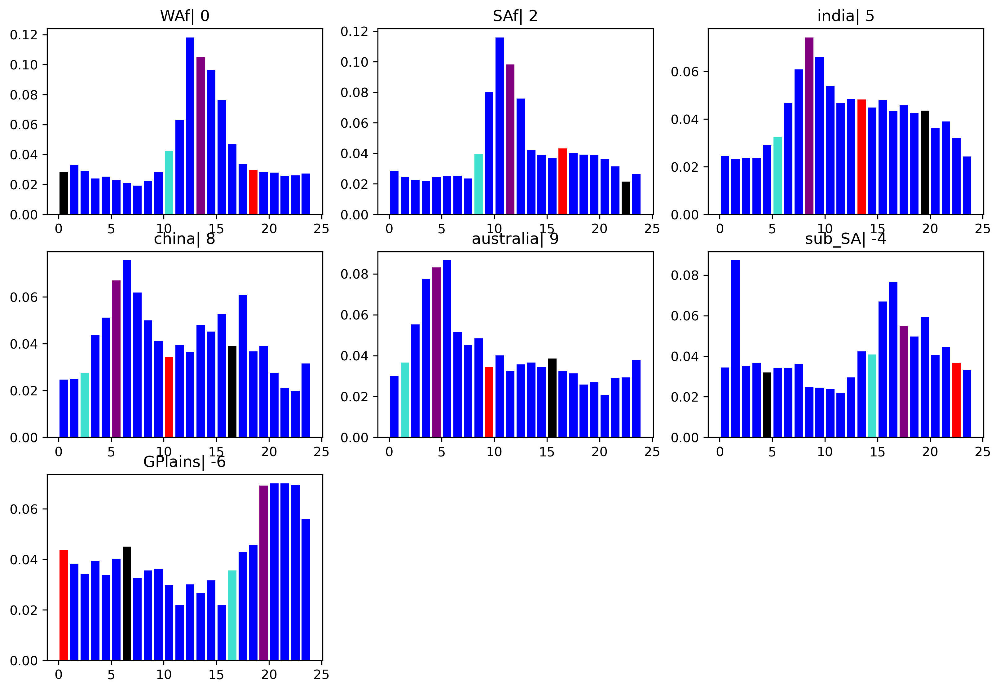

In [14]:
f= plt.figure(figsize=(13,9), dpi=300)
for ids, regs in enumerate(MREGIONS.keys()):
    ax = f.add_subplot(3,3,ids+1)
    
    pick = rdics[regs]
    hist_freq, hist_count, bin_edge = u_stats.histo_frequency(pick['init_hour'], bins=np.arange(0,25))
    #print(np.unique(pick['hour']))
    mid_bin = bin_edge[0:-1] + (bin_edge[1::]-bin_edge[0:-1])/2
    #m_bin = mid_bin - (MREGIONS[regs])[2]
    #print(mid_bin)
    colors = ['b']*24
    ispos = int(np.where(mid_bin==18.5)[0])
    secpos = int(np.where(mid_bin==13.5)[0])
    firstpos = int(np.where(mid_bin==10.5)[0])
    thirdpos = int(np.where(mid_bin==0.5)[0])
    #minpos = ispos-(MREGIONS[regs])[2]
    #ipdb.set_trace()
    minpos = ispos-(MREGIONS[regs])[2]
    miinpos = firstpos - (MREGIONS[regs])[2]
    miiinpos = secpos - (MREGIONS[regs])[2]
    midnightpos = thirdpos - (MREGIONS[regs])[2]
    print(minpos)
    if minpos == 24:
        minpos=0
    
    colors[minpos] = 'r'
    colors[miinpos] = 'turquoise'
    colors[miiinpos] = 'purple'
    colors[midnightpos] = 'k'
    ax.bar(mid_bin,hist_freq, align='center', color=colors)
    ax.set_title(regs + '| '+str((MREGIONS[regs])[2]))


In [107]:
def create_dic(dic):
    
    tt = np.array(dic['tmin'])
    mask = np.where(tt<=-50)
    
    pp = np.array(dic['pmax'])[mask] 
    sh = np.array(dic['shear'])[mask]  # 925-650 hPa shear
    umin = np.array(dic['u650'])[mask] # minimum 650hPa zonal wind 
    umax = np.array(dic['u925'])[mask] # maximum 925hPa zonal wind
    qq = np.array(dic['q925'])[mask]   # 925hPa spec humidity
    qup = np.array(dic['q650'])[mask]  # 650hPa spec humidity
    tlow = np.array(dic['t925'])[mask] # 925hPa temperature
    tt = np.array(dic['tmin'])[mask]   # minimum cloud top temperature
    ttm = np.array(dic['tmean'])[mask] # mean cloud top temperature
    month = np.array(dic['month'])[mask] 
    hour = np.array(dic['hour'])[mask]
    year = np.array(dic['year'])[mask]
   # minute = np.array(dic['minute'])[mask]
    day = np.array(dic['day'])[mask]
    date = np.array(dic['date'])[mask]
    area = np.array(dic['area'])[mask] # -50C storm area
    lat = np.array(dic['clat'])[mask] # location of minimum temperature
    lon = np.array(dic['clon'])[mask] # location of minimum temperature
    tcwv = np.array(dic['tcwv'])[mask] # total column water vapour
    rh = np.array(dic['rh925'])[mask] # 925hPa relative humidity
    #pall = np.array(dic['p'])[mask] # precipitation field within -50C cloud area


    obs_pcp = {
        'prcp' : pp,
        'q925' : qq*1000,
        'q650' : qup*1000,
        't925' : tlow-273.15,
        'shear' : sh*-1,
        'month' : month,    
        'hour' : hour,
        'year' : year,
      #  'minute' : minute,
        'day' : day,
        'date' : date,
        'area' : (area)*(5**2),
        'tmin' : tt,
        'rh' : rh,
        'tcwv' : tcwv,
        'lat' : lat,
        'lon' : lon,
        #'pall' : pall
    } 
    
    obs = pd.DataFrame(obs_pcp)
    return obs



file_path = cnst.CLOVER_SAVES + 'bulk_-50_5000km2_GPM_5-10N_10W10E_p15_ERA0.7_fullYear*.p'
ds = glob.glob(file_path)

for ids, dss in enumerate(ds):
    data = pkl.load( open (dss, 'rb'))

    obs_gpmf_h = create_dic(data)
    if ids > 0:
        obs_gpmf = pd.concat([obs_gpmf, obs_gpmf_h])
    else:
        obs_gpmf = obs_gpmf_h

    del data
obs = obs_gpmf[obs_gpmf.prcp>5]
obs = pd.DataFrame(obs)

In [113]:
obs

,prcp,q925,q650,t925,shear,month,hour,year,day,date,area,tmin,rh,tcwv,lat,lon
0,7.657979,14.724190,4.140953,25.701318,6.841075,1,17,2007,28,2007-01-28 17:30:00,6325,-75.300844,65.575134,38.754639,7.356987,-1.882976
2,15.055140,14.724190,4.140953,25.701318,6.841075,1,18,2007,28,2007-01-28 18:30:00,11500,-69.499090,65.575134,38.754639,7.404227,-2.109662
3,5.943133,15.173133,4.058833,25.401636,5.112180,1,17,2007,29,2007-01-29 17:30:00,5975,-72.302664,68.002640,40.713509,6.358965,-0.271936
4,36.356035,16.458932,5.158984,23.484399,10.712464,1,17,2007,29,2007-01-29 17:30:00,9325,-63.217142,84.037170,44.086544,7.397655,-7.537494
5,7.684593,16.889343,4.339702,21.651758,11.828568,1,16,2007,31,2007-01-31 16:00:00,12050,-78.338737,96.645584,51.395821,5.408220,-7.923906
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2672,12.618616,17.474011,4.316392,22.397241,9.893822,12,17,2008,17,2008-12-17 17:00:00,5650,-81.180647,95.546036,48.703316,5.587612,7.445095
2673,12.350243,16.071051,4.687850,23.121545,9.465675,12,17,2008,17,2008-12-17 17:00:00,5350,-76.991820,83.916214,48.527660,6.088415,-0.980034
2674,44.925868,16.082516,6.127825,20.624200,7.371384,12,17,2008,18,2008-12-18 17:00:00,55575,-83.975624,96.535057,52.119255,5.832236,-7.297491
2675,43.569980,16.232213,5.767504,22.369257,8.320564,12,17,2008,18,2008-12-18 17:00:00,13200,-77.568508,88.686577,53.128746,5.710372,-4.322611


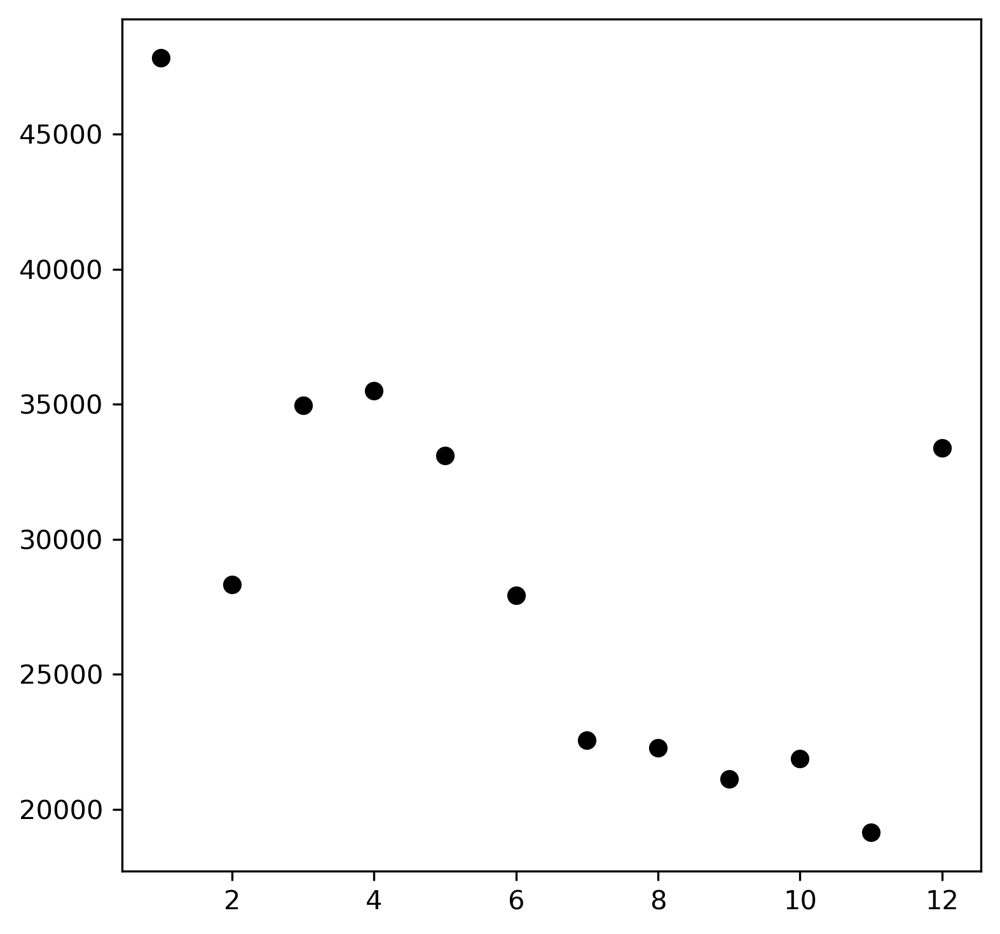

In [115]:
f= plt.figure(figsize=(10,5), dpi=300)

ax = f.add_subplot(1,2,1)
    
pick =obs
coll = []
for m in range(1,13):
    pickm = pick[pick['month'] == m]
    meant =  pickm['area'].mean()
    coll.append(meant)


ax.scatter(range(1,13),np.array(coll), color='k')
#ax.set_title(regs + '| delta:  '+str(np.round(np.array(coll).max()-np.array(coll).min(),1)))
plt.tight_layout()
#f.savefig('/home/ck/Desktop/lmcs/seasonal_cycle_storm_mint.jpg')

Text(0.5, 1.0, 'Storm area West Africa | 5000km2 min, -50C')

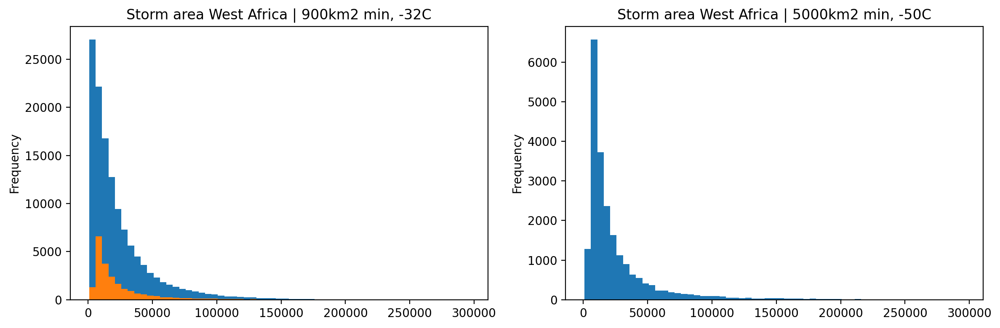

In [125]:
f = plt.figure(figsize=(12,4), dpi=200)
ax = f.add_subplot(121)
(rdics['WAf'])['pf_area1'].plot.hist(bins=range(900,300000,5000)) # ccs_area, pf_area1
plt.title('Storm area West Africa | 900km2 min, -32C')

ax = f.add_subplot(122)
(obs['area']).plot.hist(bins=range(900,300000,5000))
plt.tight_layout()
plt.title('Storm area West Africa | 5000km2 min, -50C')

Text(0.5, 1.0, 'Storm area West Africa | 5000km2 min, -50C')

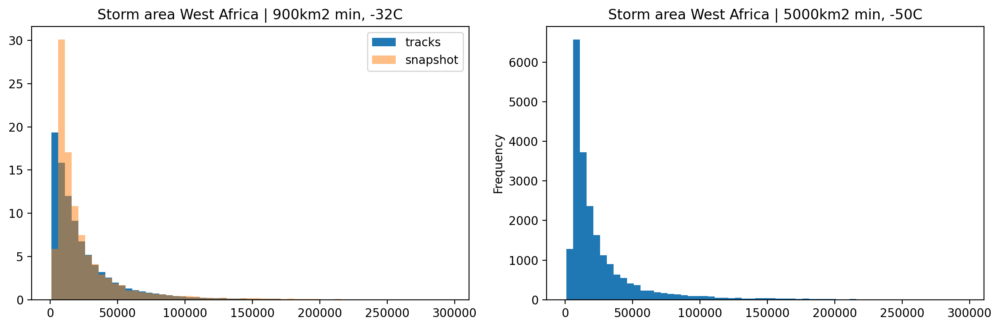

In [138]:
from utils import u_plot
f = plt.figure(figsize=(12,4), dpi=200)
ax = f.add_subplot(121)
#hist, count, h = stats.histo_frequency((rdics['WAf'])['pf_area1'], bins=range(900,300000,5000))
u_plot.hist_freq(ax, rdics['WAf']['pf_area1'], bins=range(900,300000,5000), label='tracks') # ccs_area, pf_area1
u_plot.hist_freq(ax, obs['area'], bins=range(900,300000,5000), label='snapshot', alpha=0.5) # ccs_area, pf_area1
plt.title('Storm area West Africa | 900km2 min, -32C')
#ax.set_xlim(10000,200000)
plt.legend()

ax = f.add_subplot(122)
(obs['area']).plot.hist(bins=range(900,300000,5000))
plt.tight_layout()
plt.title('Storm area West Africa | 5000km2 min, -50C')